In [2]:
import sys
sys.path.append("../../")
DATA_PATH = "../../data/"
SAVE_PATH = "../../plots"

import matplotlib.pyplot as plt
import numpy as np
import py_common.utility as utility
from py_common.units import *
from py_common.scattering_dependence import *
from py_common.bounds_dependence import *
from py_common.wave_function import *
from matplotlib.collections import LineCollection
import itertools
from matplotlib.figure import Figure
from matplotlib.axes import Axes
from py_common.utility import AxesArray
from ipywidgets import interact
import pickle
from py_common.aggregate_outputs import *

plt.rcParams.update({'font.size': 18})

n_colors = ["#FF0088", "#00FF9D", "#0BA6FF", "#8C0AE2"]
BINS = [-0.246, -1.660, -5.280]
ROT_CONST = 0.24975935 * CMINV / GHZ

reference_singlet = np.loadtxt(f"{DATA_PATH}/srf_rb_bounds_n_175_singlet.dat")
reference_singlet_scaled_1 = np.loadtxt(f"{DATA_PATH}/srf_rb_bounds_n_175_singlet_scaled_1.dat")

reference_triplet = np.loadtxt(f"{DATA_PATH}/srf_rb_bounds_n_175_triplet.dat")
reference_triplet_scaled_1 = np.loadtxt(f"{DATA_PATH}/srf_rb_bounds_n_175_triplet_scaled_1.dat")

colors = ["red", "green", "blue", "purple", "navy", "black"]

def bounds_loss(bounds, bounds_true):
    chi = 0
    for i, b in enumerate(bounds_true):
        if i >= len(bounds):
            chi += 1
        else:
            chi += (np.log2(bounds[i] / b))**2
    chi /= i # type: ignore

    return chi

def bounds_losses(bounds, bounds_true):
    fields = np.unique(bounds.data[:, 0])

    losses = []
    for bounds_single in bounds.fields():
        losses.append(bounds_loss(bounds_single[:, 1], bounds_true))

    return np.array([np.array(fields), np.array(losses)])

def plot_bounds(ax: Axes, bounds: BoundsDependence, x_scaled = lambda x: x, color_levels: list[int] = [0, 1, 2]):
    for state in bounds.states():
        points = np.column_stack([x_scaled(state[:, 0]), np.cbrt(state[:, 1])])
        segments = np.stack([points[:-1], points[1:]], axis=1)
    
        occupations = state[:, 2:]

        colors = np.zeros((points.shape[0], 3))
        if occupations is not None:
            for k in range(min(3, len(color_levels))):
                if color_levels[k] < occupations.shape[1]:
                    colors[:, k] = occupations[:, color_levels[k]]

        if colors is not None:
            colors = np.clip(colors, 0, 1)
        
        lc = LineCollection(segments, colors=colors[:-1]) # type: ignore
        ax.add_collection(lc)
        
        ax.update_datalim(points)
        ax.autoscale_view()


def plot_2d_bounds(
    bound_dependence: BoundsDependence2D, 
    reference: npt.NDArray[np.float64], 
    axis: int = 1, 
    c6_mult = 1.,
    label = "scaling view factor ="
) -> tuple[Figure, AxesArray]:
    fig, axes = utility.plot_many(1, 2, shape=(15, 5), sharex = True)

    def update(scaling_index = 0):
        for art in list(axes[0].lines):
            art.remove()
        for art in list(axes[0].collections):
            art.remove()

        bounds_index, scaling_view = bound_dependence.slice(scaling_index, axis)

        for state in bounds_index.states():
            if state.shape[1] == 3:
                axes[0].plot(state[:, 0], np.cbrt(state[:, 1]), color="blue")
            else:
                points = np.column_stack([state[:, 0], np.cbrt(state[:, 1])])
                segments = np.stack([points[:-1], points[1:]], axis=1)
                colors = np.column_stack([state[:, 2], state[:, 3], state[:, 4]])

                lc = LineCollection(segments, colors=colors[:-1]) # type: ignore
                
                axes[0].add_collection(lc)

        for b in reference:
            axes[0].axhline(np.cbrt(b), color = "red", linestyle="--", linewidth=1)

        for b in BINS:
            axes[0].axhline(np.cbrt(b / c6_mult**0.5), color = "black", linestyle="--", linewidth=0.5)

        for art in list(axes[1].lines):
            art.remove()

        chi2 = bounds_losses(bounds_index, reference)
        axes[1].plot(chi2[0, :], chi2[1, :], color = "blue")

        fig.suptitle(f"{label} {scaling_view:.4f}")

        fig.canvas.draw_idle()
    
    update(scaling_index=0)

    interact(update, scaling_index = (0, bound_dependence.slice_len(axis) - 1))

    return fig, axes

@dataclass
class WKBLevel:
    n: int
    slope: float
    energy_diss: float
    intercept: float

    def levels_cbrt(self, lambd):
        return np.cbrt(self.energy_diss - np.power(self.slope * (np.sqrt(lambd) - self.intercept), 3) / np.sqrt(lambd))

class WKBLevels:
    levels: list[WKBLevel]
    slope: float
    rot_const: float
    spacing: float
    range_lambda: tuple[float, float]
    range_level_cbrt: tuple[float, float]

    def __init__(self, slope: float, rot_const: float, spacing: float, range_lambda: tuple[float, float], range_level_cbrt: tuple[float, float]):
        self.levels = []
        self.slope = slope
        self.rot_const = rot_const
        self.spacing = spacing
        self.range_lambda = range_lambda
        self.range_level_cbrt = range_level_cbrt

    # @staticmethod
    # def from_n_0(self, first, range_lambda: tuple[float, float], range_level_cbrt: tuple[float, float]) -> 'WKBLevels':
    #    pass

    def add_level_cbrt(self, n: int, point: tuple[float, float], slope: float | None = None, spacing: float | None = None):
        spacing = spacing if spacing is not None else self.spacing
        slope = slope if slope is not None else self.slope

        assert point[0] >= self.range_lambda[0] and point[0] <= self.range_lambda[1]
        assert point[1] >= self.range_level_cbrt[0] and point[1] <= self.range_level_cbrt[1]

        energy_diss = n * (n + 1) * self.rot_const
        intercept = np.cbrt(point[1]**3 * np.sqrt(point[0]) - energy_diss) / slope + np.sqrt(point[0])

        lowest_intercept = np.cbrt(self.range_level_cbrt[0]**3 * np.sqrt(self.range_lambda[0]) - energy_diss) / slope + np.sqrt(self.range_lambda[0])
        highest_intercept = np.cbrt(self.range_level_cbrt[1]**3 * np.sqrt(self.range_lambda[1]) - energy_diss) / slope + np.sqrt(self.range_lambda[1])

        k_min = int(np.ceil((lowest_intercept - intercept) / spacing))
        k_max = int(np.floor((highest_intercept - intercept) / spacing))

        for k in range(k_min, k_max + 1):
            self.levels.append(WKBLevel(n, slope, energy_diss, intercept + k * spacing))


# Adiabats

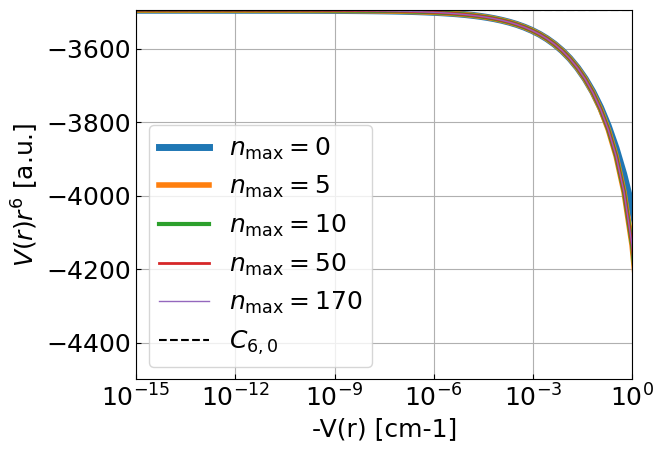

In [ ]:
fig, ax = utility.plot()
rot_const = 0.24975935

linwidths = [5, 4, 3, 2, 1]

for i, n_max in enumerate([0, 5, 10, 50, 170]):
    data = utility.load(f"{DATA_PATH}/SrF_Rb_singlet_n_max_{n_max}_adiabats_long_range.dat")
    ax.plot(-data[:, 1] / CMINV, data[:, 1] * data[:, 0]**6, label = fr"$n_\text{{max}} = {n_max}$", linewidth = linwidths[i])

ax.axhline(-3495.30040855597, color = "black", linestyle = "--", label = "$C_{6,0}$")
ax.set_ylim(-4500, -3494)
ax.set_xlim(1e-15, 1)
# ax.set_xlim(10, 3000)
ax.set_xscale("log")
ax.set_xlabel("-V(r) [cm-1]")
ax.set_ylabel("$V(r) r^6$ [a.u.]")
ax.legend(loc = "lower left");

# fig.savefig(f"{SAVE_PATH}/lowest_adiabat_long_range.pdf", bbox_inches = "tight")

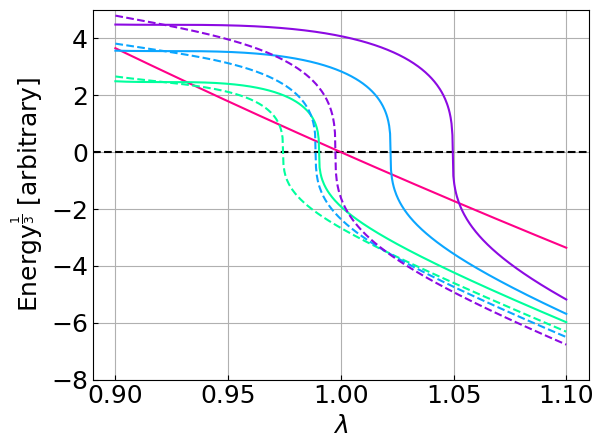

In [ ]:
fig, ax = utility.plot()

lambdas = np.linspace(0.9, 1.1, 500)

ax.axhline(0, linestyle = "--", color = "black", label = "dissociation")

level = WKBLevel(0, 70., 0., 1.)
ax.plot(lambdas, level.levels_cbrt(lambdas), color = n_colors[level.n], label = "$n = 0$")

level = WKBLevel(1, 70., 2 * ROT_CONST, 0.96)
ax.plot(lambdas, level.levels_cbrt(lambdas), color = n_colors[level.n], label = "$n = 1$")

level = WKBLevel(2, 70., 6 * ROT_CONST, 0.96)
ax.plot(lambdas, level.levels_cbrt(lambdas), color = n_colors[level.n], label = "$n = 2$")

level = WKBLevel(3, 70., 12 * ROT_CONST, 0.96)
ax.plot(lambdas, level.levels_cbrt(lambdas), color = n_colors[level.n], label = "$n = 3$")

energy_diss = 2 * ROT_CONST
slope = 70
intercept = 0.96
n = 1
q_l = 150 * 2

value = np.cbrt(energy_diss - np.power(slope * (np.sqrt(lambdas) - intercept), 3) - q_l * (np.sqrt(lambdas) - intercept))
ax.plot(lambdas, value, color = n_colors[n], linestyle = "--", label = "$n = 1$")

n = 2
energy_diss = 6 * ROT_CONST
q_l = 150 * 6
value = np.cbrt(energy_diss - np.power(slope * (np.sqrt(lambdas) - intercept), 3) - q_l * (np.sqrt(lambdas) - intercept))
ax.plot(lambdas, value, color = n_colors[n], linestyle = "--", label = "$n = 2$")

n = 3
energy_diss = 12 * ROT_CONST
q_l = 150 * 12
value = np.cbrt(energy_diss - np.power(slope * (np.sqrt(lambdas) - intercept), 3) - q_l * (np.sqrt(lambdas) - intercept))
ax.plot(lambdas, value, color = n_colors[n], linestyle = "--", label = "$n = 3$")

ax.set_ylim(-8, 5);
ax.set_xlabel(r"$\lambda$")
ax.set_ylabel(r"Energy$^\frac{1}{3}$ [arbitrary]")

# fig.savefig(f"{SAVE_PATH}/levels_shapes.pdf", bbox_inches = "tight")
# ax.legend();

# WKB

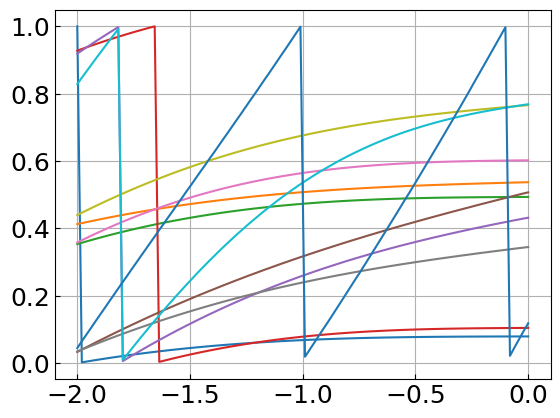

In [ ]:
data = utility.load(f"{DATA_PATH}/SrF_Rb_singlet_wkb_test.dat")

fig, ax = utility.plot()
ax.plot(np.cbrt(data[:, 0]), data[:, 1:] % 1);

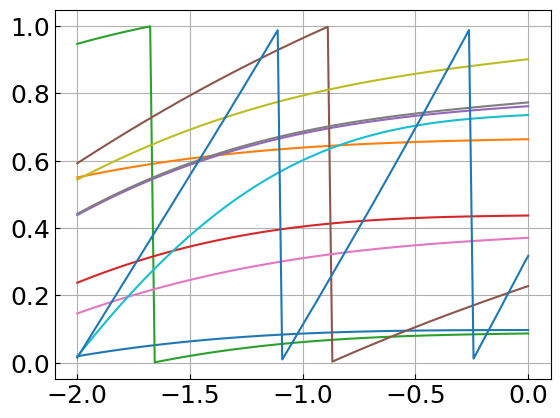

In [ ]:
data = utility.load(f"{DATA_PATH}/SrF_Rb_singlet_wkb_scaled_1_02.dat")

fig, ax = utility.plot()
ax.plot(np.cbrt(data[:, 0]), data[:, 1:] % 1);

# Bound states

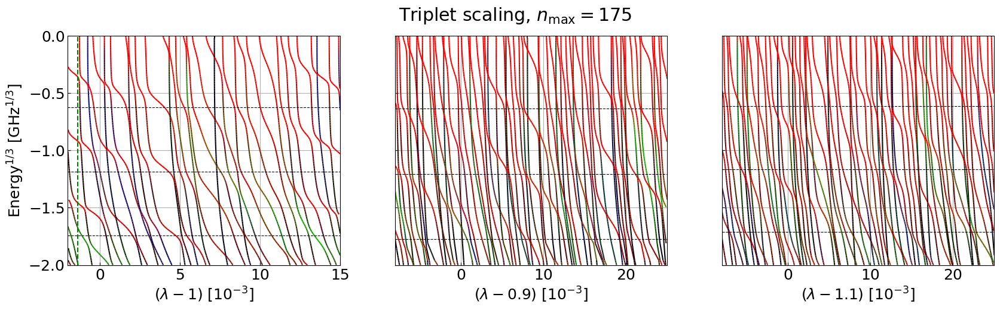

In [3]:
fig, axes = utility.plot_many(1, 3, (20, 5), sharey=True)
centers = [1, 0.9, 1.1]
suffixes = ["", "_low", "_high"]

def scaling(a, center: float = 1., mult = 1000):
    return (a - center) * mult

for ax, c, suffix in zip(axes, centers, suffixes):
    bounds = BoundsDependence(f"{DATA_PATH}/field_triplet_n_175_wave_function{suffix}.dat")
    plot_bounds(ax, bounds, lambda x: scaling(x, c))

    for value in BINS:
        ax.axhline(np.cbrt(value / c**0.5), linestyle="--", color="black", linewidth=0.8)

for ax in axes:
    ax.set_ylim(-2, 0)

axes[0].set_ylabel(f"Energy$^{{1/3}}$ [GHz$^{{1/3}}$]")
axes[0].set_xlim(-2, 15)
axes[1].set_xlim(-8, 25)
axes[2].set_xlim(-8, 25)

axes[0].set_xlabel(r"$(\lambda - 1)$ [$10^{-3}$]")
axes[1].set_xlabel(r"$(\lambda - 0.9)$ [$10^{-3}$]")
axes[2].set_xlabel(r"$(\lambda - 1.1)$ [$10^{-3}$]")

axes[0].axvline(scaling(0.9986), linestyle="--", color="green")

# fig.savefig(f"{SAVE_PATH}/bound_triplet_n_175_scaling.pdf", bbox_inches = "tight")
fig.suptitle(r"Triplet scaling, $n_\text{max} = 175$ ");

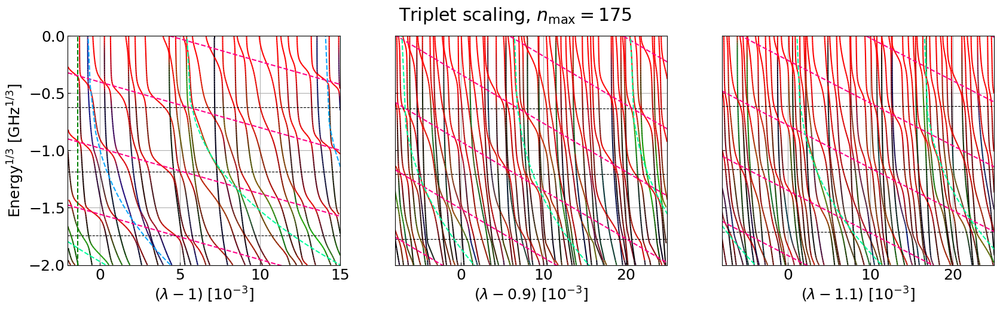

In [ ]:
fig_c: Figure = pickle.loads(pickle.dumps(fig))
axes_c = AxesArray(fig_c.axes, 1, 3)

lambdas = np.linspace(1 - 2e-3, 1 + 15e-3, 1000)
levels = WKBLevels(80, ROT_CONST, 0.0072, (lambdas[0], lambdas[-1]), (-2, 0))

levels.add_level_cbrt(0, (1 + 5e-3, -1.18))
levels.add_level_cbrt(1, (1 + 5.5e-3, -0.5))
levels.add_level_cbrt(2, (1, -1))

for l in levels.levels:
    axes_c[0].plot(scaling(lambdas), l.levels_cbrt(lambdas), linestyle = "--", color = n_colors[l.n])

lambdas = np.linspace(0.9 - 8e-3, 0.9 + 25e-3, 1000)
levels = WKBLevels(80, ROT_CONST, 0.0072, (lambdas[0], lambdas[-1]), (-2, 0))

levels.add_level_cbrt(0, (0.9 + 10e-3, -1.35))
levels.add_level_cbrt(1, (0.9 + 22e-3, -0.85))

for l in levels.levels:
    axes_c[1].plot(scaling(lambdas, 0.9), l.levels_cbrt(lambdas), linestyle = "--", color = n_colors[l.n])

lambdas = np.linspace(1.1 - 8e-3, 1.1 + 25e-3, 1000)
levels = WKBLevels(80, ROT_CONST, 0.0072, (lambdas[0], lambdas[-1]), (-2, 0))

levels.add_level_cbrt(0, (1.1, -1.35))
levels.add_level_cbrt(1, (1.1 + 17.5e-3, -1.15))

for l in levels.levels:
    axes_c[2].plot(scaling(lambdas, 1.1), l.levels_cbrt(lambdas), linestyle = "--", color = n_colors[l.n])

fig_c.suptitle("")
# fig_c.savefig(f"{SAVE_PATH}/bound_triplet_n_175_scaling_overlines.pdf", bbox_inches = "tight")
fig_c.suptitle(r"Triplet scaling, $n_\text{max} = 175$ ");

fig_c

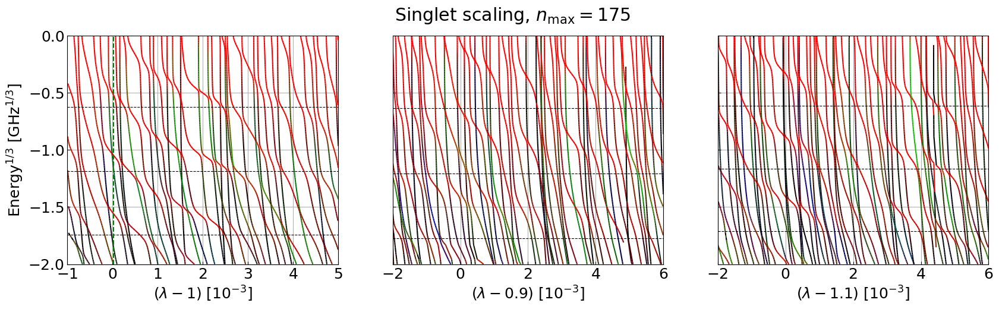

In [6]:
fig, axes = utility.plot_many(1, 3, (20, 5), sharey=True)
centers = [1, 0.9, 1.1]
suffixes = ["", "_low", "_high"]

def scaling(a, center: float = 1., mult = 1000):
    return (a - center) * mult

for ax, c, suffix in zip(axes, centers, suffixes):
    bounds = BoundsDependence(f"{DATA_PATH}/field_singlet_n_175_wave_function{suffix}.dat")
    plot_bounds(ax, bounds, lambda x: scaling(x, c))

    for value in BINS:
        ax.axhline(np.cbrt(value / c**0.5), linestyle="--", color="black", linewidth=0.8)
        # ax.axhline(np.cbrt(value / (1.37 * c)**0.5), linestyle="--", color="blue", linewidth=0.8)

axes[0].set_ylabel(f"Energy$^{{1/3}}$ [GHz$^{{1/3}}$]")
axes[0].set_ylim(-2, 0)

axes[0].set_xlim(-1, 5)
axes[1].set_xlim(-2, 6)
axes[2].set_xlim(-2, 6)

axes[0].set_xlabel(r"$(\lambda - 1)$ [$10^{-3}$]")
axes[1].set_xlabel(r"$(\lambda - 0.9)$ [$10^{-3}$]")
axes[2].set_xlabel(r"$(\lambda - 1.1)$ [$10^{-3}$]")

axes[0].axvline(scaling(1.00002), linestyle="--", color="green")

# fig.savefig(f"{SAVE_PATH}/bound_singlet_n_175_scaling.pdf", bbox_inches = "tight")
fig.suptitle(r"Singlet scaling, $n_\text{max} = 175$ ");

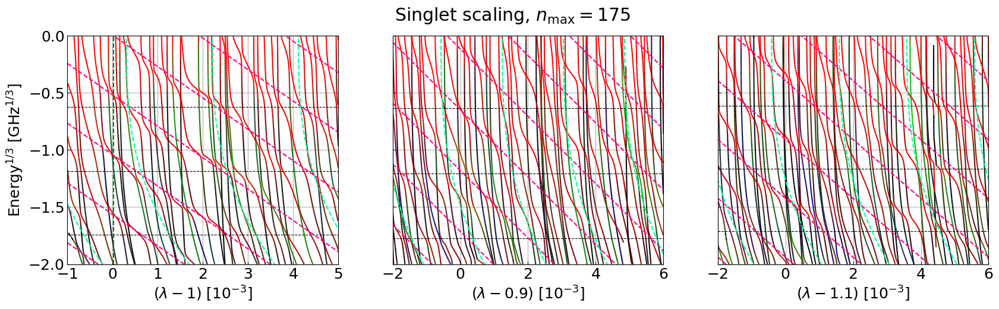

In [7]:
fig_c: Figure = pickle.loads(pickle.dumps(fig))
axes_c = AxesArray(fig_c.axes, 1, 3)

lambdas = np.linspace(1 - 1e-3, 1 + 5e-3, 1000)
levels = WKBLevels(550, ROT_CONST, 0.00095, (lambdas[0], lambdas[-1]), (-2, 0))

levels.add_level_cbrt(0, (1 + 2e-3, -1.07))
levels.add_level_cbrt(1, (1 + 0.5e-3, -1.))

for l in levels.levels:
    axes_c[0].plot(scaling(lambdas), l.levels_cbrt(lambdas), linestyle = "--", color = n_colors[l.n])

lambdas = np.linspace(0.9 - 2e-3, 0.9 + 6e-3, 1000)
levels = WKBLevels(550, ROT_CONST, 0.00095, (lambdas[0], lambdas[-1]), (-2, 0))

levels.add_level_cbrt(0, (0.9, -0.65))
levels.add_level_cbrt(1, (0.9 + 5e-3, -0.3))

for l in levels.levels:
    axes_c[1].plot(scaling(lambdas, 0.9), l.levels_cbrt(lambdas), linestyle = "--", color = n_colors[l.n])

lambdas = np.linspace(1.1 - 2e-3, 1.1 + 6e-3, 1000)
levels = WKBLevels(550, ROT_CONST, 0.00095, (lambdas[0], lambdas[-1]), (-2, 0))

levels.add_level_cbrt(0, (1.1, -0.91))
levels.add_level_cbrt(1, (1.1 + 4e-3, -1.4))

for l in levels.levels:
    axes_c[2].plot(scaling(lambdas, 1.1), l.levels_cbrt(lambdas), linestyle = "--", color = n_colors[l.n])

fig_c.suptitle("")
# fig_c.savefig(f"{SAVE_PATH}/bound_singlet_n_175_scaling_overlines.pdf", bbox_inches = "tight")
fig_c.suptitle(r"Singlet scaling, $n_\text{max} = 175$ ");

fig_c

## n_max = 10

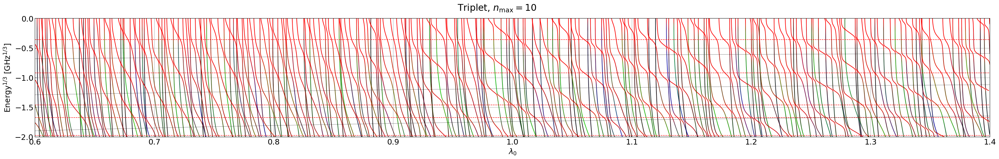

In [20]:
fig, ax = utility.plot(shape = (40, 5))

lambda_min = 0.6
lambda_max = 1.4
lambdas = np.linspace(lambda_min, lambda_max, 1000)

bounds = BoundsDependence.parse_field_json(f"{DATA_PATH}/SrF_Rb_field_triplet_scaling_full_n_max_10_long.json", (lambda_min, lambda_max))

plot_bounds(ax, bounds)

for b in reference_triplet_scaled_1:
    ax.axhline(np.cbrt(b), color = "red", linestyle="--", linewidth=1)

for b in BINS:
    ax.plot(lambdas, np.cbrt(b / np.sqrt(lambdas)), color = "black", linestyle="--", linewidth=0.5)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda_0$")
ax.set_ylim(-2, 0);
ax.set_xlim(lambda_min, lambda_max);

# fig.savefig(f"{SAVE_PATH}/srf_rb_triplet_bounds_n_10_long.pdf", bbox_inches = "tight")
fig.suptitle(r"Triplet, $n_\text{max} = 10$");

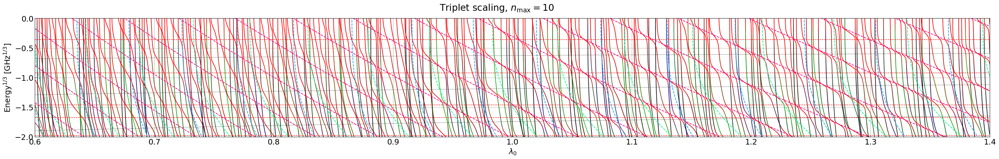

In [ ]:
fig_c: Figure = pickle.loads(pickle.dumps(fig))
ax_c: Axes = fig_c.axes[0]

levels = WKBLevels(21, ROT_CONST, 0.0273, (0.6, 1.4), (-2, 0))

levels.add_level_cbrt(0, (1, -0.88))
levels.add_level_cbrt(1, (0.985, -0.6), spacing = 0.026)
levels.add_level_cbrt(2, (1.125, -1), spacing = 0.025)

for l in levels.levels:
    ax_c.plot(lambdas, l.levels_cbrt(lambdas), linestyle = "--", color = n_colors[l.n])

fig_c.suptitle("")
# fig_c.savefig(f"{SAVE_PATH}/srf_rb_triplet_bounds_n_10_long_overlines.pdf", bbox_inches = "tight")
fig_c.suptitle(r"Triplet scaling, $n_\text{max} = 10$ ");
fig_c

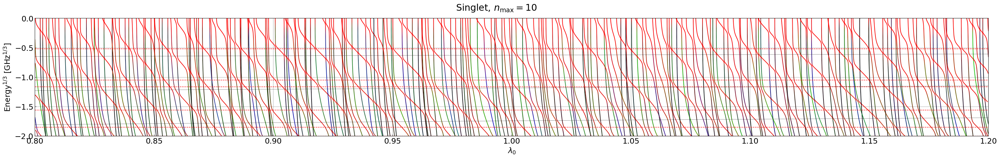

In [ ]:
fig, ax = utility.plot(shape = (40, 5))

lambda_min = 0.8
lambda_max = 1.2
lambdas = np.linspace(lambda_min, lambda_max, 1000)

bounds = BoundsDependence.parse_field_json(f"{DATA_PATH}/SrF_Rb_field_singlet_scaling_full_n_max_10_long.json", (lambda_min, lambda_max))

plot_bounds(ax, bounds)

for b in reference_singlet_scaled_1:
    ax.axhline(np.cbrt(b), color = "red", linestyle="--", linewidth=1)

for b in BINS:
    ax.plot(lambdas, np.cbrt(b / np.sqrt(lambdas)), color = "black", linestyle="--", linewidth=0.5)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda_0$")
ax.set_ylim(-2, 0);
ax.set_xlim(lambda_min, lambda_max);

# fig.savefig(f"{SAVE_PATH}/srf_rb_singlet_bounds_n_10_long.pdf", bbox_inches = "tight")
fig.suptitle(r"Singlet, $n_\text{max} = 10$");

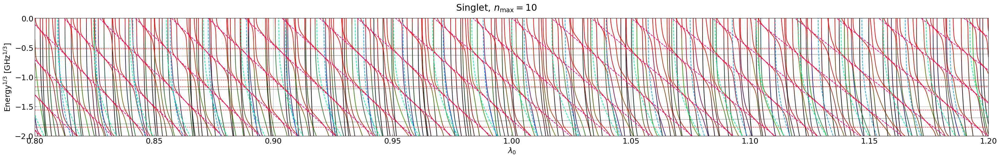

In [ ]:
fig_c: Figure = pickle.loads(pickle.dumps(fig))
ax_c: Axes = fig_c.axes[0]

levels = WKBLevels(70, ROT_CONST, 0.00824, (0.8, 1.2), (-2, 0))

levels.add_level_cbrt(0, (1, -1.15))
levels.add_level_cbrt(1, (0.985, -1), spacing = 0.008255)
levels.add_level_cbrt(2, (0.989, -1), spacing = 0.0084)

for l in levels.levels:
    ax_c.plot(lambdas, l.levels_cbrt(lambdas), linestyle = "--", color = n_colors[l.n])

fig_c.suptitle("")
# fig_c.savefig(f"{SAVE_PATH}/srf_rb_singlet_bounds_n_10_long_overlines.pdf", bbox_inches = "tight")
fig_c.suptitle(r"Singlet, $n_\text{max} = 10$");

fig_c

# Reconstruction

## older

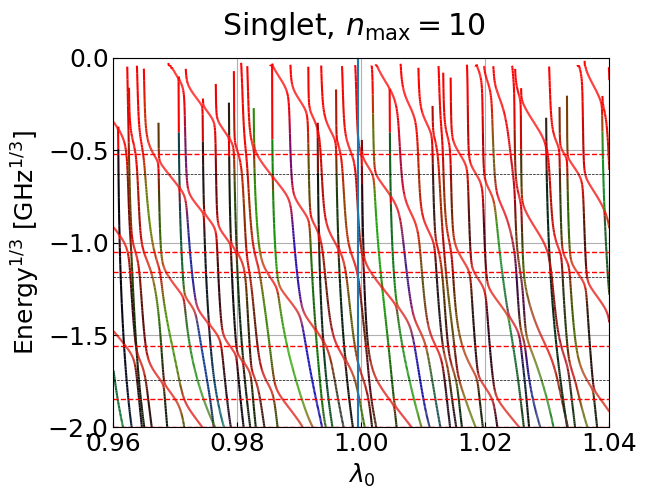

In [ ]:
fig, ax = utility.plot()

bounds = BoundsDependence.parse_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_scaling_full_n_max_10_long.json", (1 - 0.04, 1 + 0.04))

plot_bounds(ax, bounds)

for b in reference_singlet_scaled_1:
    ax.axhline(np.cbrt(b), color = "red", linestyle="--", linewidth=1)

for b in BINS:
    ax.axhline(np.cbrt(b), color = "black", linestyle="--", linewidth=0.5)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda_0$")
ax.set_ylim(-2, 0);
ax.set_xlim(1.0 - 0.04, 1.0 + 0.04);

ax.axvline(0.9995)

# fig.savefig(f"{SAVE_PATH}/srf_rb_singlet_bounds_n_10.pdf", bbox_inches = "tight")
fig.suptitle(r"Singlet, $n_\text{max} = 10$");

interactive(children=(IntSlider(value=0, description='scaling_index', max=50), Output()), _dom_classes=('widge…

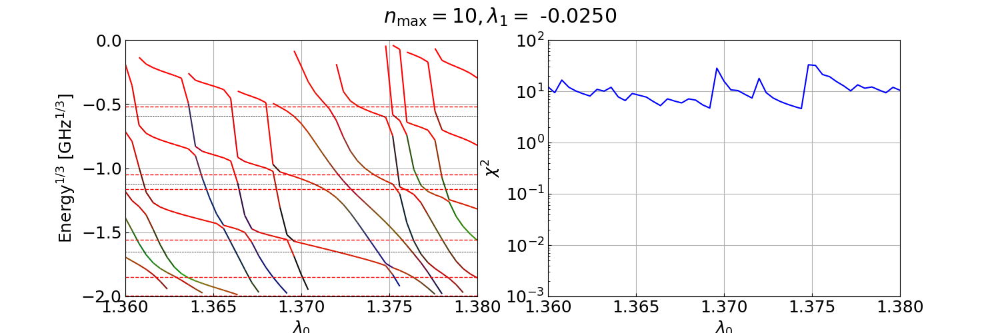

In [ ]:
%matplotlib widget

bounds_singlet_2d_zoomed = BoundsDependence2D.parse_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_2d_scaling_legendre_0_legendre_1_n_max_10_morphing_1_37.json")

fig, axes = plot_2d_bounds(bounds_singlet_2d_zoomed, reference_singlet_scaled_1, c6_mult=1.37, label = r"$n_\text{max} = 10, \lambda_1 =$")

axes[0].set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
axes[0].set_xlabel(r"$\lambda_0$")
axes[0].set_ylim(-2, 0)
axes[0].set_xlim(1.37 - 0.01, 1.37 + 0.01)

axes[1].set_yscale("log")
axes[1].set_ylim(1e-3, 1e2)
axes[1].set_ylabel(r"$\chi^2$")
axes[1].set_xlabel(r"$\lambda_0$");

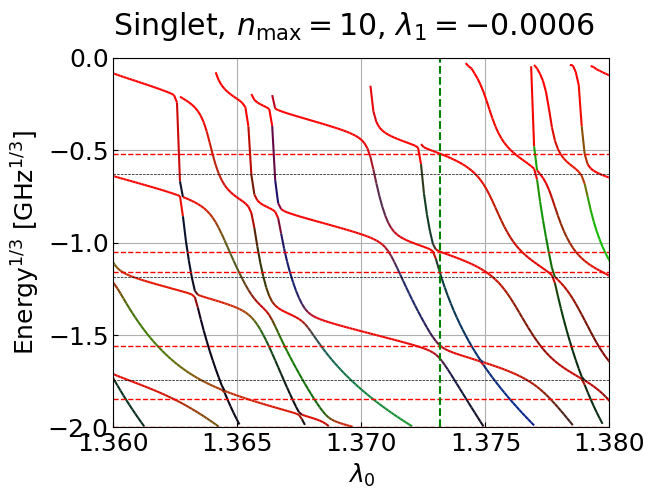

In [ ]:
fig, ax = utility.plot()

bounds = BoundsDependence.parse_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_scaling_full_n_max_10_c6_1_3_lambda_-6e-4.json")

plot_bounds(ax, bounds)

for b in reference_singlet_scaled_1:
    ax.axhline(np.cbrt(b), color = "red", linestyle="--", linewidth=1)

for b in BINS:
    ax.axhline(np.cbrt(b), color = "black", linestyle="--", linewidth=0.5)

ax.axvline(1.3731587996463799, color = "green", linestyle = "--")

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda_0$")
ax.set_ylim(-2, 0);
ax.set_xlim(1.37 - 0.01, 1.37 + 0.01);

# fig.savefig(f"{SAVE_PATH}/srf_rb_singlet_bounds_n_10_reconstruction_1_37.pdf", bbox_inches = "tight")
fig.suptitle(r"Singlet, $n_\text{max} = 10$, $\lambda_1 = -0.0006$");

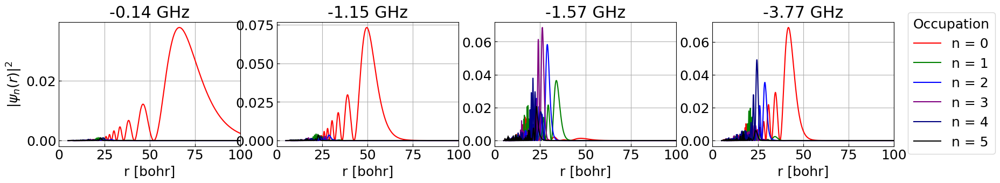

In [ ]:
n_max = 5
take = 4

wave_functions = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_wave_functions_n_max_10_scaling_1_37.json", n_max + 1)

fig, axes = utility.plot_many(1, take, shape = (5 * take, 3))
axes[0].set_ylabel(r"$|\psi_n(r)|^2$")

for i, (n, wave) in itertools.islice(enumerate(wave_functions.items()), take):
    for j in range(wave.values.shape[1]):
        axes[i].plot(wave.distances, wave.values[:, j] ** 2, color = colors[j])

    axes[i].set_xlabel("r [bohr]")
    axes[i].set_title(f"{wave.energy:.2f} GHz")
    axes[i].set_xlim(0, 100)

fig.legend([f"n = {j}" for j in range(n_max + 1)],
           loc='center right', bbox_to_anchor=(1, 0.5),
           title='Occupation');

# fig.savefig(f"{SAVE_PATH}/wave_function_singlet_scaled_n_10_scale_1_37.pdf", bbox_inches = "tight")

morphing \
[1.4340338097242147, 0.06516772306037935]

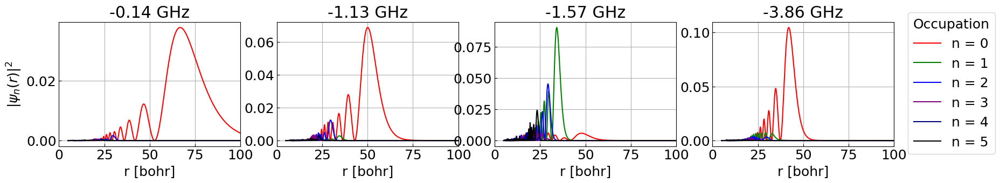

In [2]:
n_max = 5
take = 4

wave_functions = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_wave_functions_n_max_10_scaling_1_43.json", n_max + 1)

fig, axes = utility.plot_many(1, take, shape = (5 * take, 3))
axes[0].set_ylabel(r"$|\psi_n(r)|^2$")

for i, (n, wave) in itertools.islice(enumerate(wave_functions.items()), take):
    for j in range(wave.values.shape[1]):
        axes[i].plot(wave.distances, wave.values[:, j] ** 2, color = colors[j])

    axes[i].set_xlabel("r [bohr]")
    axes[i].set_title(f"{wave.energy:.2f} GHz")
    axes[i].set_xlim(0, 100)

fig.legend([f"n = {j}" for j in range(n_max + 1)],
           loc='center right', bbox_to_anchor=(1, 0.5),
           title='Occupation');

# fig.savefig(f"{SAVE_PATH}/wave_function_singlet_scaled_n_10_scale_1_37.pdf", bbox_inches = "tight")

morphing \
[1.4340338097242147, 0.06516772306037935]

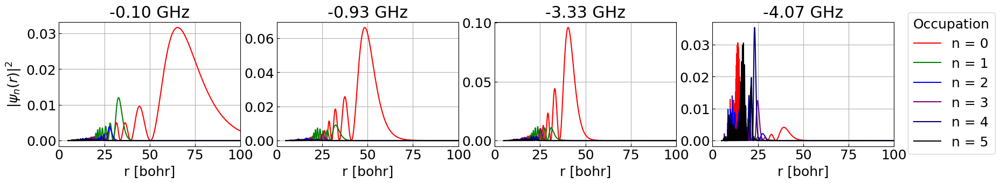

In [5]:
n_max = 5
take = 4

wave_functions = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_triplet_wave_functions_n_max_10_1_02.json", n_max + 1)

fig, axes = utility.plot_many(1, take, shape = (5 * take, 3))
axes[0].set_ylabel(r"$|\psi_n(r)|^2$")

for i, (n, wave) in itertools.islice(enumerate(wave_functions.items()), take):
    for j in range(wave.values.shape[1]):
        axes[i].plot(wave.distances, wave.values[:, j] ** 2, color = colors[j])

    axes[i].set_xlabel("r [bohr]")
    axes[i].set_title(f"{wave.energy:.2f} GHz")
    axes[i].set_xlim(0, 100)

fig.legend([f"n = {j}" for j in range(n_max + 1)],
           loc='center right', bbox_to_anchor=(1, 0.5),
           title='Occupation');

# fig.savefig(f"{SAVE_PATH}/wave_function_singlet_scaled_n_10_scale_1_37.pdf", bbox_inches = "tight")

## Singlet reconstruction

lambda_1 = 1.3731588;

scaling_c = -0.000636864;

lambda_1 + (scaling - scaling_c) * 21.6 / 20.

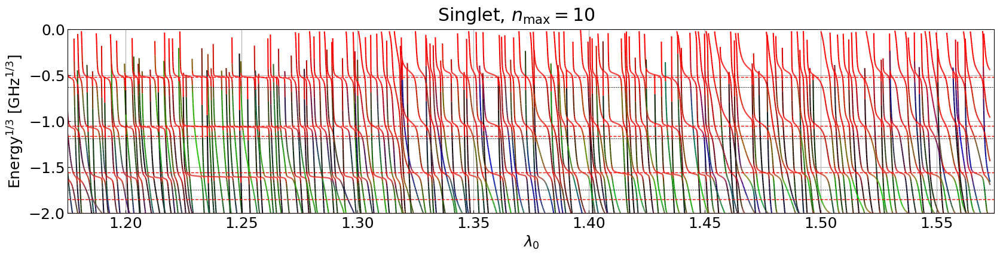

In [ ]:
fig, ax = utility.plot(shape = (20, 4))

bounds = BoundsDependence.parse_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_scaling_full_n_max_10_invariant_v2.json")

plot_bounds(ax, bounds)

for b in reference_singlet_scaled_1:
    ax.axhline(np.cbrt(b), color = "red", linestyle="--", linewidth=1)

for b in BINS:
    ax.axhline(np.cbrt(b), color = "black", linestyle="--", linewidth=0.5)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda_0$")
ax.set_ylim(-2, 0);
ax.set_xlim(1.375 - 0.2, 1.375 + 0.2);

# fig.savefig(f"{SAVE_PATH}/srf_rb_singlet_bounds_n_10.pdf", bbox_inches = "tight")
fig.suptitle(r"Singlet, $n_\text{max} = 10$");

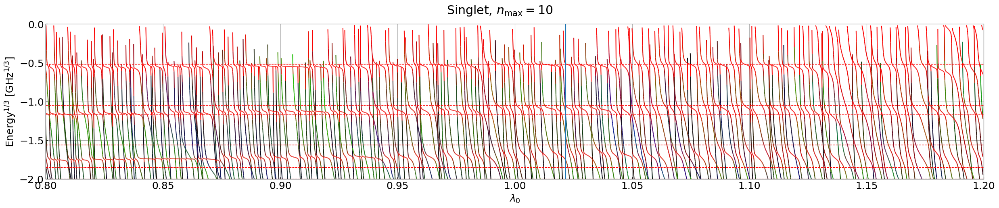

In [ ]:
fig, ax = utility.plot(shape = (30, 5))

bounds = BoundsDependence.parse_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_scaling_full_n_max_10_invariant_s_1.json")

plot_bounds(ax, bounds)

for b in reference_singlet_scaled_1:
    ax.axhline(np.cbrt(b), color = "red", linestyle="--", linewidth=1)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda_0$")
ax.set_ylim(-2, 0);
ax.set_xlim(1.0 - 0.2, 1.0 + 0.2);

ax.axvline(1.02165)
ax.axvline(0.85)
# ax.axvline(1.1628)

# fig.savefig(f"{SAVE_PATH}/srf_rb_singlet_bounds_n_10.pdf", bbox_inches = "tight")
fig.suptitle(r"Singlet, $n_\text{max} = 10$");

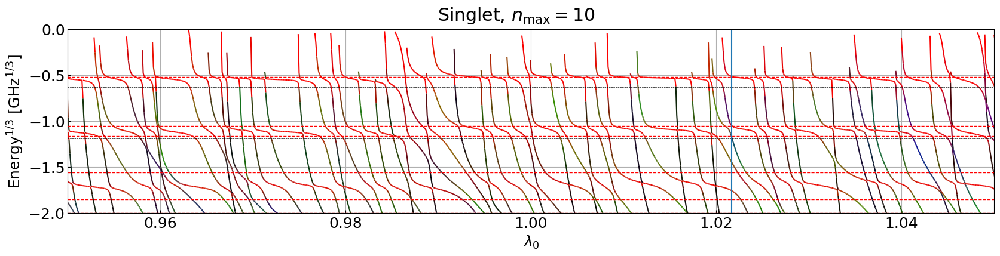

In [ ]:
fig, ax = utility.plot(shape = (20, 4))

bounds = BoundsDependence.parse_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_scaling_full_n_max_10_invariant_s_1.json")

plot_bounds(ax, bounds)

for b in reference_singlet_scaled_1:
    ax.axhline(np.cbrt(b), color = "red", linestyle="--", linewidth=1)

for b in BINS:
    ax.axhline(np.cbrt(b), color = "black", linestyle="--", linewidth=0.5)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda_0$")
ax.set_ylim(-2, 0);
ax.set_xlim(1.0 - 0.05, 1.0 + 0.05);

ax.axvline(1.02165)

# fig.savefig(f"{SAVE_PATH}/srf_rb_singlet_bounds_n_10.pdf", bbox_inches = "tight")
fig.suptitle(r"Singlet, $n_\text{max} = 10$");

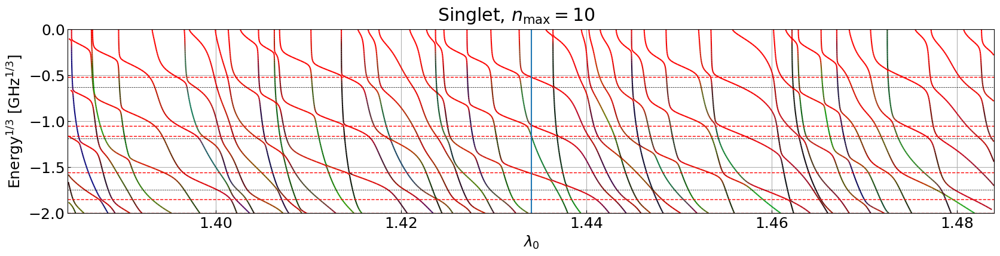

In [ ]:
fig, ax = utility.plot(shape = (20, 4))

bounds = BoundsDependence.parse_field_json(f"{DATA_PATH}/SrF_Rb_field_singlet_scaling_full_n_max_10_1_43.json")

plot_bounds(ax, bounds)

for b in reference_singlet_scaled_1:
    ax.axhline(np.cbrt(b), color = "red", linestyle="--", linewidth=1)

for b in BINS:
    ax.axhline(np.cbrt(b), color = "black", linestyle="--", linewidth=0.5)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda_0$")
ax.set_ylim(-2, 0);
ax.set_xlim(1.434 - 0.05, 1.434 + 0.05)

ax.axvline(1.4340338097242147)

# fig.savefig(f"{SAVE_PATH}/srf_rb_singlet_bounds_n_10.pdf", bbox_inches = "tight")
fig.suptitle(r"Singlet, $n_\text{max} = 10$");

morphing \
[1.4340338097242147, 0.06516772306037935]

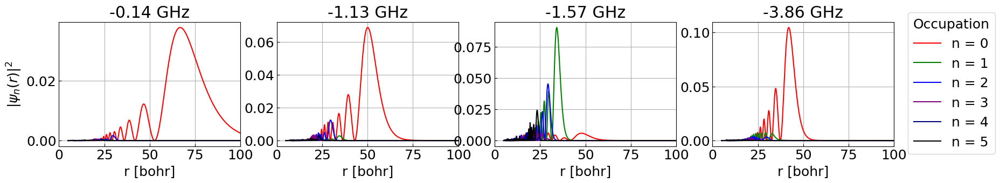

In [ ]:
max_coeff = 5
waves = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_wave_functions_n_max_10_scaling_1_43.json", take = max_coeff + 1)

take = 4

fig, axes = utility.plot_many(1, take, shape = (5 * take, 3))
axes[0].set_ylabel(r"$|\psi_n(r)|^2$")

for i, (state, wave) in itertools.islice(enumerate(waves.items()), take):
    for j in range(wave.values.shape[1]):
        axes[i].plot(wave.distances, wave.values[:, j]**2, color = colors[j])
    axes[i].set_xlabel("r [bohr]")
    axes[i].set_title(f"{wave.energy:.2f} GHz")
    axes[i].set_xlim(0, 100)

fig.legend([f"n = {j}" for j in range(max_coeff + 1)],
           loc='center right', bbox_to_anchor=(1, 0.5),
           title='Occupation');

# fig.savefig(f"{SAVE_PATH}/wave_function_triplet_scaled_n_10.pdf", bbox_inches = "tight")

interactive(children=(IntSlider(value=0, description='scaling_index', max=20), Output()), _dom_classes=('widge…

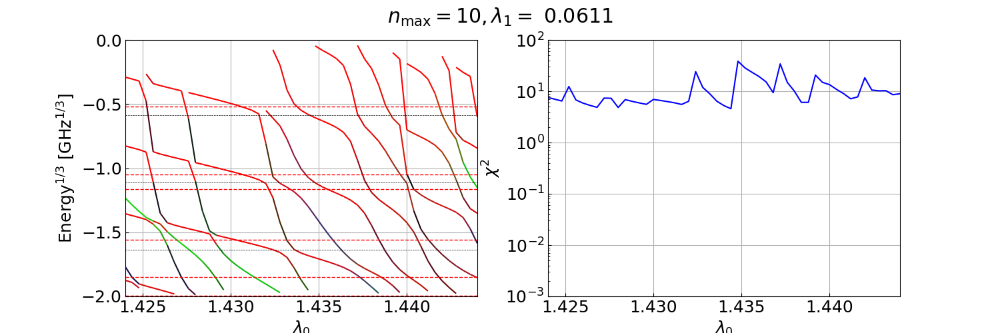

In [ ]:
%matplotlib widget

bounds_singlet_2d_zoomed = BoundsDependence2D.parse_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_2d_scaling_legendre_0_legendre_1_n_max_10_morphing_1_43.json")

fig, axes = plot_2d_bounds(bounds_singlet_2d_zoomed, reference_singlet_scaled_1, c6_mult=1.445, label = r"$n_\text{max} = 10, \lambda_1 =$")

axes[0].set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
axes[0].set_xlabel(r"$\lambda_0$")
axes[0].set_ylim(-2, 0)
axes[0].set_xlim(1.434 - 0.01, 1.434 + 0.01)

axes[1].set_yscale("log")
axes[1].set_ylim(1e-3, 1e2)
axes[1].set_ylabel(r"$\chi^2$")
axes[1].set_xlabel(r"$\lambda_0$");

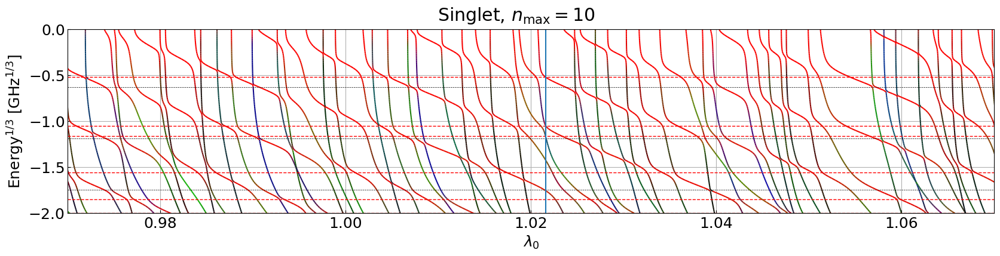

In [ ]:
fig, ax = utility.plot(shape = (20, 4))

bounds = BoundsDependence.parse_field_json(f"{DATA_PATH}/SrF_Rb_field_singlet_scaling_full_n_max_10_1_02.json")

plot_bounds(ax, bounds)

for b in reference_singlet_scaled_1:
    ax.axhline(np.cbrt(b), color = "red", linestyle="--", linewidth=1)

for b in BINS:
    ax.axhline(np.cbrt(b), color = "black", linestyle="--", linewidth=0.5)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda_0$")
ax.set_ylim(-2, 0);
ax.set_xlim(1.02 - 0.05, 1.02 + 0.05)

ax.axvline(1.021560818780792)

# fig.savefig(f"{SAVE_PATH}/srf_rb_singlet_bounds_n_10.pdf", bbox_inches = "tight")
fig.suptitle(r"Singlet, $n_\text{max} = 10$");

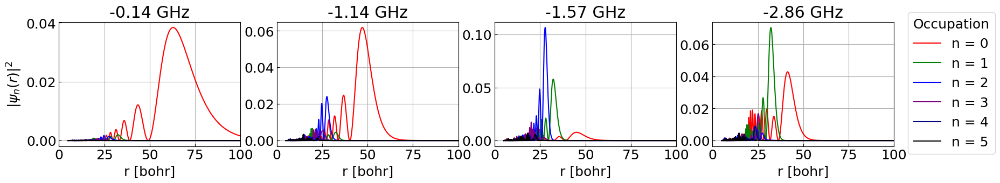

In [ ]:
max_coeff = 5
waves = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_wave_functions_n_max_10_morphing_02.json", take = max_coeff + 1)

take = 4

fig, axes = utility.plot_many(1, take, shape = (5 * take, 3))
axes[0].set_ylabel(r"$|\psi_n(r)|^2$")

for i, (state, wave) in itertools.islice(enumerate(waves.items()), take):
    for j in range(wave.values.shape[1]):
        axes[i].plot(wave.distances, wave.values[:, j]**2, color = colors[j])
    axes[i].set_xlabel("r [bohr]")
    axes[i].set_title(f"{wave.energy:.2f} GHz")
    axes[i].set_xlim(0, 100)

fig.legend([f"n = {j}" for j in range(max_coeff + 1)],
           loc='center right', bbox_to_anchor=(1, 0.5),
           title='Occupation');

# fig.savefig(f"{SAVE_PATH}/wave_function_triplet_scaled_n_10.pdf", bbox_inches = "tight")

## Triplet reconstruction

lambda_1 = 0.;

scaling_c = 1.003;

lambda_1 + (scaling - scaling_c) * 26. / 20.

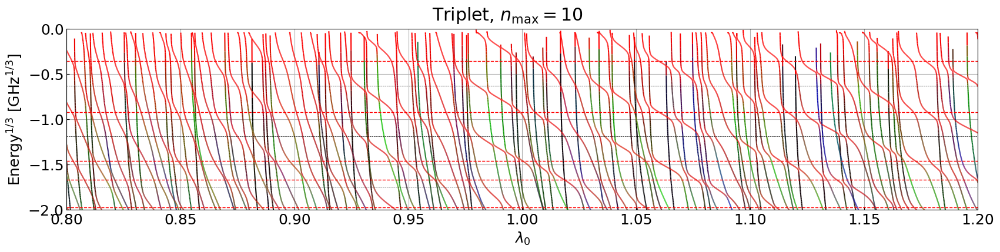

In [ ]:
fig, ax = utility.plot(shape = (20, 4))

bounds = BoundsDependence.parse_json(f"{DATA_PATH}/SrF_Rb_bounds_triplet_scaling_full_n_max_10_long.json", (1 - 0.2, 1 + 0.2))

plot_bounds(ax, bounds)

for b in reference_triplet_scaled_1:
    ax.axhline(np.cbrt(b), color = "red", linestyle="--", linewidth=1)

for b in BINS:
    ax.axhline(np.cbrt(b), color = "black", linestyle="--", linewidth=0.5)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda_0$")
ax.set_ylim(-2, 0);
ax.set_xlim(1. - 0.2, 1. + 0.2);

# fig.savefig(f"{SAVE_PATH}/srf_rb_triplet_bounds_n_10.pdf", bbox_inches = "tight")
fig.suptitle(r"Triplet, $n_\text{max} = 10$");

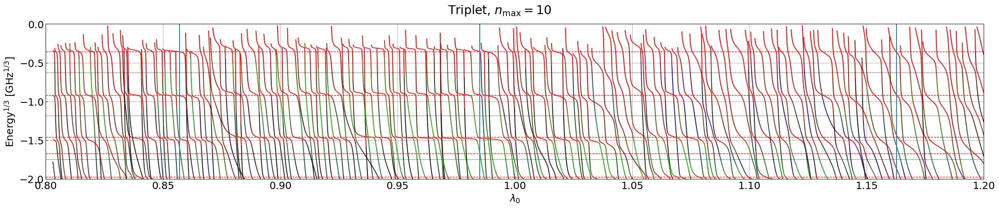

In [ ]:
fig, ax = utility.plot(shape = (30, 5))

bounds = BoundsDependence.parse_json(f"{DATA_PATH}/SrF_Rb_bounds_triplet_scaling_full_n_max_10_invariant.json", (1 - 0.2, 1 + 0.2))

plot_bounds(ax, bounds)

for b in reference_triplet_scaled_1:
    ax.axhline(np.cbrt(b), color = "red", linestyle="--", linewidth=1)

for b in BINS:
    ax.axhline(np.cbrt(b), color = "black", linestyle="--", linewidth=0.5)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda_0$")
ax.set_ylim(-2, 0);
ax.set_xlim(1. - 0.2, 1. + 0.2);

ax.axvline(0.9851)
ax.axvline(0.857)
ax.axvline(1.1628)

# fig.savefig(f"{SAVE_PATH}/srf_rb_triplet_bounds_n_10.pdf", bbox_inches = "tight")
fig.suptitle(r"Triplet, $n_\text{max} = 10$");

morphing \
[0.9849947036736354, -0.02322520097349072]

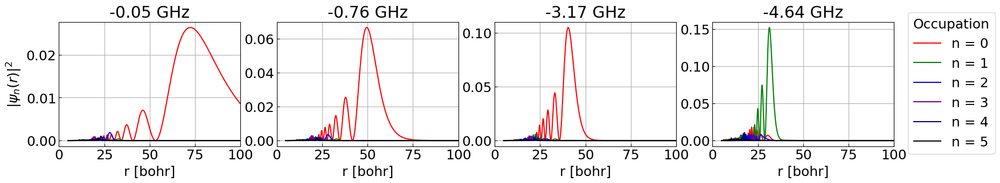

In [ ]:
max_coeff = 5
waves = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_triplet_wave_functions_n_max_10_morphing_1.json", take = max_coeff + 1)

take = 4

fig, axes = utility.plot_many(1, take, shape = (5 * take, 3))
axes[0].set_ylabel(r"$|\psi_n(r)|^2$")

for i, (state, wave) in itertools.islice(enumerate(waves.items()), take):
    for j in range(wave.values.shape[1]):
        axes[i].plot(wave.distances, wave.values[:, j]**2, color = colors[j])
    axes[i].set_xlabel("r [bohr]")
    axes[i].set_title(f"{wave.energy:.2f} GHz")
    axes[i].set_xlim(0, 100)

fig.legend([f"n = {j}" for j in range(max_coeff + 1)],
           loc='center right', bbox_to_anchor=(1, 0.5),
           title='Occupation');

# fig.savefig(f"{SAVE_PATH}/wave_function_triplet_scaled_n_10.pdf", bbox_inches = "tight")

## new scalings n_max = 10

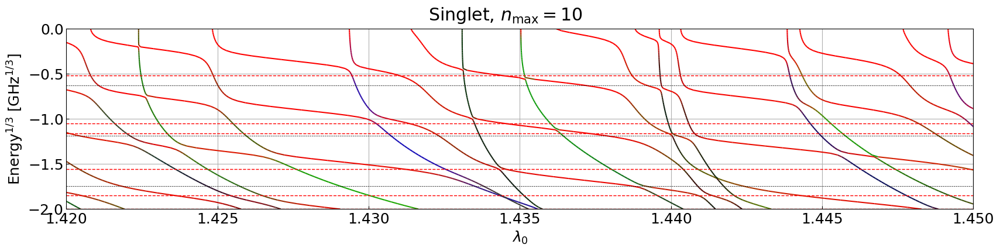

In [ ]:
fig, ax = utility.plot(shape = (20, 4))

bounds = BoundsDependence.parse_field_json(f"{DATA_PATH}/SrF_Rb_field_singlet_scaling_full_n_max_10_scaling_1_43.json")

plot_bounds(ax, bounds)

for b in reference_singlet_scaled_1:
    ax.axhline(np.cbrt(b), color = "red", linestyle="--", linewidth=1)

for b in BINS:
    ax.axhline(np.cbrt(b), color = "black", linestyle="--", linewidth=0.5)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda$")
ax.set_ylim(-2, 0);
ax.set_xlim(1.42, 1.45)

# fig.savefig(f"{SAVE_PATH}/srf_rb_singlet_bounds_n_10.pdf", bbox_inches = "tight")
fig.suptitle(r"Singlet, $n_\text{max} = 10$");

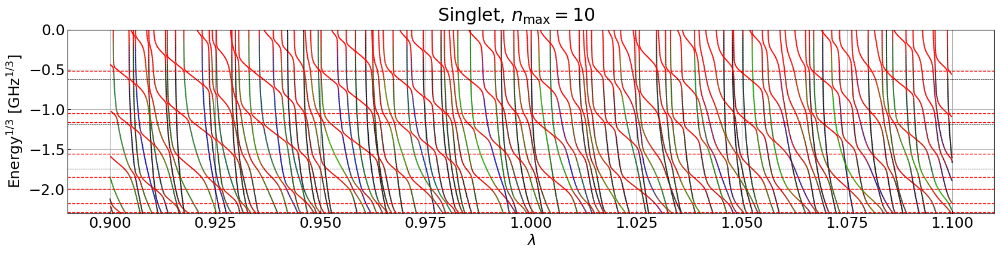

In [ ]:
fig, ax = utility.plot(shape = (20, 4))

bounds = BoundsDependence.parse_field_json(f"{DATA_PATH}/SrF_Rb_field_singlet_scaling_full_n_max_10_scaling_1_00.json")

plot_bounds(ax, bounds)

for b in reference_singlet_scaled_1:
    ax.axhline(np.cbrt(b), color = "red", linestyle="--", linewidth=1)

for b in BINS:
    ax.axhline(np.cbrt(b), color = "black", linestyle="--", linewidth=0.5)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda$")
ax.set_ylim(-2.3, 0);

# fig.savefig(f"{SAVE_PATH}/srf_rb_singlet_bounds_n_10.pdf", bbox_inches = "tight")
fig.suptitle(r"Singlet, $n_\text{max} = 10$");

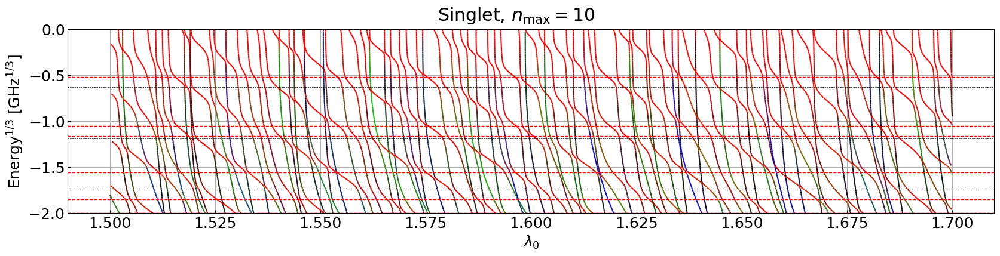

In [ ]:
fig, ax = utility.plot(shape = (20, 4))

bounds = BoundsDependence.parse_field_json(f"{DATA_PATH}/SrF_Rb_field_singlet_scaling_full_n_max_10_scaling_1_6.json")

plot_bounds(ax, bounds)

for b in reference_singlet_scaled_1:
    ax.axhline(np.cbrt(b), color = "red", linestyle="--", linewidth=1)

for b in BINS:
    ax.axhline(np.cbrt(b), color = "black", linestyle="--", linewidth=0.5)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda$")
ax.set_ylim(-2, 0);

# fig.savefig(f"{SAVE_PATH}/srf_rb_singlet_bounds_n_10.pdf", bbox_inches = "tight")
fig.suptitle(r"Singlet, $n_\text{max} = 10$");

interactive(children=(IntSlider(value=0, description='scaling_index', max=80), Output()), _dom_classes=('widge…

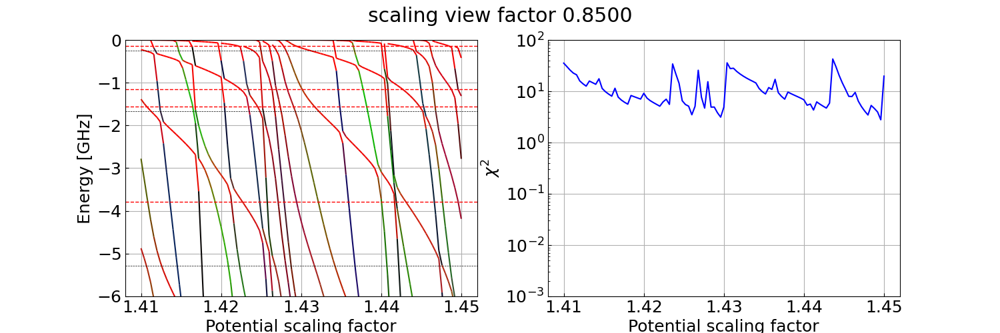

In [ ]:
# triplet n = 10 2d scaling zoomed
%matplotlib widget

bounds_singlet_2d_zoomed = BoundsDependence2D.parse_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_2d_scaling_n_max_10_scaling_1_43.json")
fig, axes = plot_2d(bounds_singlet_2d_zoomed, reference_singlet_scaled_1)

label = "Potential scaling factor"

axes[0].set_ylabel(f"Energy [GHz]")
axes[0].set_xlabel(label)
axes[0].set_ylim(-6, 0)

axes[1].set_yscale("log")
axes[1].set_ylim(1e-3, 1e2)
axes[1].set_ylabel(r"$\chi^2$")
axes[1].set_xlabel(label);

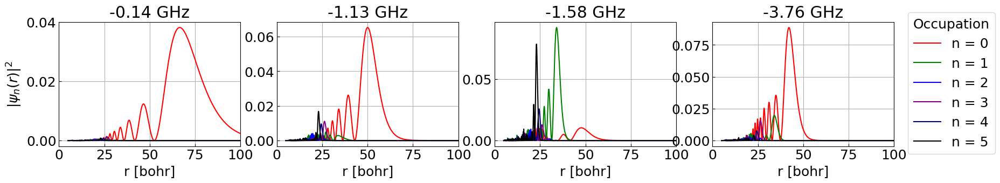

In [ ]:
n_max = 5
take = 4

wave_functions = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_wave_functions_n_max_10_scaling_1_43.json", n_max + 1)

fig, axes = utility.plot_many(1, take, shape = (5 * take, 3))
axes[0].set_ylabel(r"$|\psi_n(r)|^2$")

for i, (n, wave) in itertools.islice(enumerate(wave_functions.items()), take):
    for j in range(wave.values.shape[1]):
        axes[i].plot(wave.distances, wave.values[:, j] ** 2, color = colors[j])

    axes[i].set_xlabel("r [bohr]")
    axes[i].set_title(f"{wave.energy:.2f} GHz")
    axes[i].set_xlim(0, 100)

fig.legend([f"n = {j}" for j in range(n_max + 1)],
           loc='center right', bbox_to_anchor=(1, 0.5),
           title='Occupation');

# fig.savefig(f"{SAVE_PATH}/wave_function_singlet_scaled_n_10.pdf", bbox_inches = "tight")

interactive(children=(IntSlider(value=0, description='scaling_index', max=80), Output()), _dom_classes=('widge…

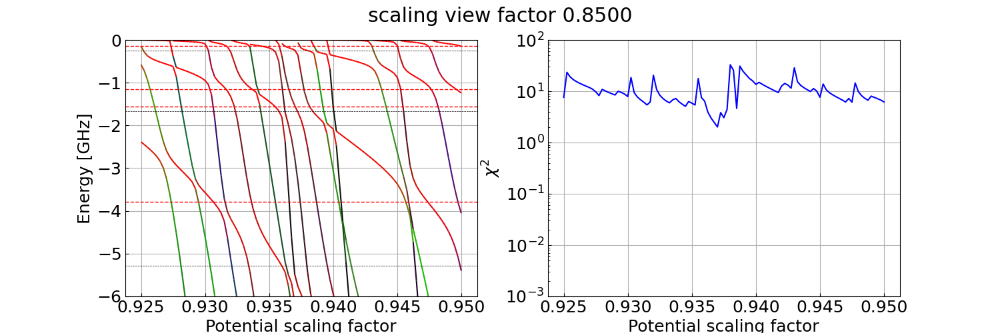

In [ ]:
# triplet n = 10 2d scaling zoomed
%matplotlib widget

bounds_singlet_2d_zoomed = BoundsDependence2D.parse_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_2d_scaling_n_max_10_scaling_0_93.json")
fig, axes = plot_2d(bounds_singlet_2d_zoomed, reference_singlet_scaled_1)

label = "Potential scaling factor"

axes[0].set_ylabel(f"Energy [GHz]")
axes[0].set_xlabel(label)
axes[0].set_ylim(-6, 0)

axes[1].set_yscale("log")
axes[1].set_ylim(1e-3, 1e2)
axes[1].set_ylabel(r"$\chi^2$")
axes[1].set_xlabel(label);

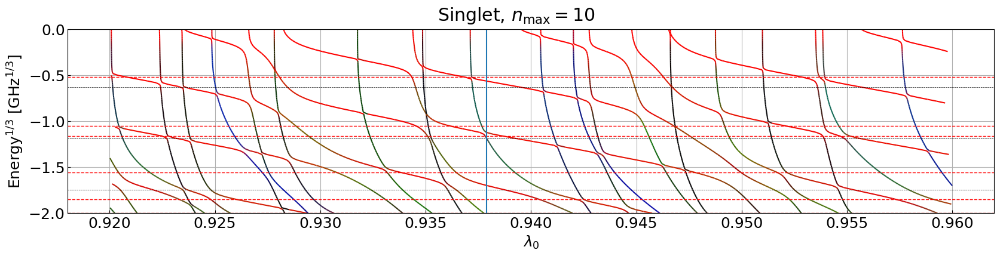

In [ ]:
fig, ax = utility.plot(shape = (20, 4))

bounds = BoundsDependence.parse_field_json(f"{DATA_PATH}/SrF_Rb_field_singlet_scaling_full_n_max_10_scaling_0_93_0_9.json")

plot_bounds(ax, bounds)

for b in reference_singlet_scaled_1:
    ax.axhline(np.cbrt(b), color = "red", linestyle="--", linewidth=1)

for b in BINS:
    ax.axhline(np.cbrt(b), color = "black", linestyle="--", linewidth=0.5)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda_0$")
ax.set_ylim(-2, 0);

ax.axvline(0.9379)

# fig.savefig(f"{SAVE_PATH}/srf_rb_singlet_bounds_n_10.pdf", bbox_inches = "tight")
fig.suptitle(r"Singlet, $n_\text{max} = 10$");

0.9389302523757846, 0.976730434834512

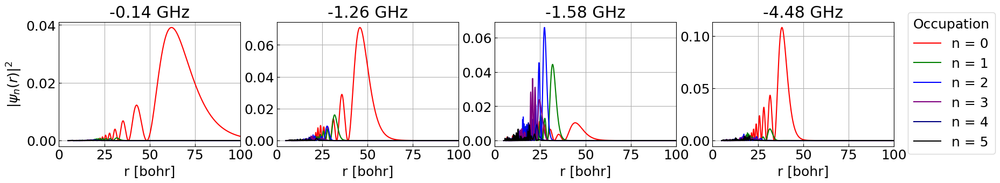

In [ ]:
%matplotlib inline
n_max = 5
take = 4

wave_functions = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_wave_functions_n_max_10_scaling_0_93.json", n_max + 1)

fig, axes = utility.plot_many(1, take, shape = (5 * take, 3))
axes[0].set_ylabel(r"$|\psi_n(r)|^2$")

for i, (n, wave) in itertools.islice(enumerate(wave_functions.items()), take):
    for j in range(wave.values.shape[1]):
        axes[i].plot(wave.distances, wave.values[:, j] ** 2, color = colors[j])

    axes[i].set_xlabel("r [bohr]")
    axes[i].set_title(f"{wave.energy:.2f} GHz")
    axes[i].set_xlim(0, 100)

fig.legend([f"n = {j}" for j in range(n_max + 1)],
           loc='center right', bbox_to_anchor=(1, 0.5),
           title='Occupation');

# fig.savefig(f"{SAVE_PATH}/wave_f unction_singlet_scaled_n_10.pdf", bbox_inches = "tight")

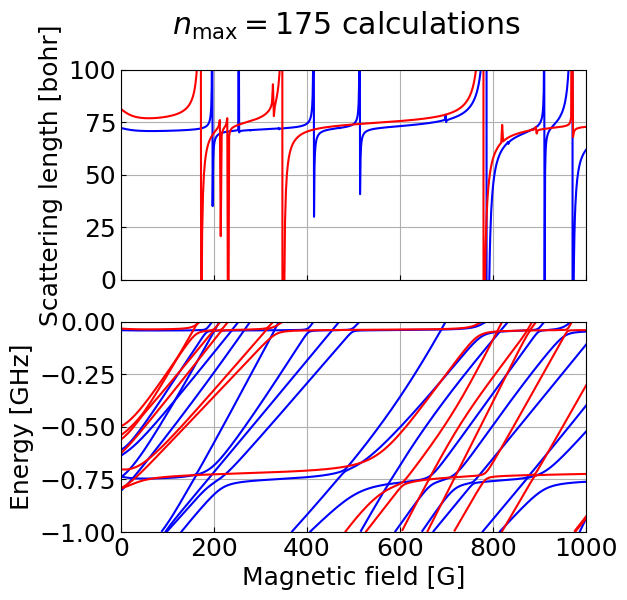

In [ ]:
fig, axes = utility.plot_many(2, 1, shape=(6, 6), sharex=True)

filename = f"{DATA_PATH}/molscat_n_max_175_scaled_1.dat"
data = np.loadtxt(filename, delimiter="\t", skiprows=1)

axes[0].plot(data[:, 1], data[:, 2] * ANGS, color = "blue")

axes[0].set_ylabel(f"Scattering length [bohr]")
axes[0].set_ylim(0, 100);

bounds_single = BoundsDependence(f"{DATA_PATH}/bound_n_max_175_scaled_1.dat")
for state in bounds_single.states():
	axes[1].plot(state[:, 0], state[:, 1], color = "blue")
	
axes[1].set_ylabel(f"Energy [GHz]")
axes[1].set_xlabel("Magnetic field [G]")
axes[1].set_ylim(-1, 0);
axes[1].set_xlim(0, 1000);

scatterings = ScatteringDependence.parse_json(f"{DATA_PATH}/SrF_Rb_scattering_n_max_10_scaled_0_94_0_98.json")
axes[0].plot(scatterings.parameters, scatterings.s_lengths().real, color = "red")

bounds = BoundsDependence.parse_json(f"{DATA_PATH}/SrF_Rb_bound_states_n_max_10_scaled_0_94_0_98.json")
for state in bounds.states():
	axes[1].plot(state[:, 0], state[:, 1], color = "red")

# fig.savefig(f"{SAVE_PATH}/feshbach_n_175.pdf", bbox_inches = "tight")
fig.suptitle(r"$n_\text{max} = 175$ calculations");

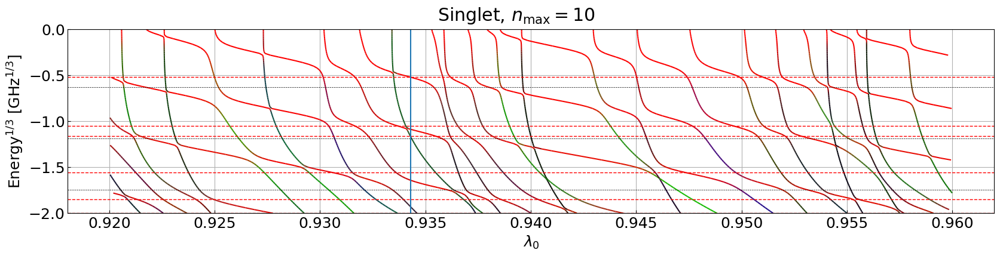

In [ ]:
fig, ax = utility.plot(shape = (20, 4))

bounds = BoundsDependence.parse_field_json(f"{DATA_PATH}/SrF_Rb_field_singlet_scaling_full_n_max_10_scaling_0_93_0_85.json")

plot_bounds(ax, bounds)

for b in reference_singlet_scaled_1:
    ax.axhline(np.cbrt(b), color = "red", linestyle="--", linewidth=1)

for b in BINS:
    ax.axhline(np.cbrt(b), color = "black", linestyle="--", linewidth=0.5)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda_0$")
ax.set_ylim(-2, 0);

ax.axvline(0.9343)

# fig.savefig(f"{SAVE_PATH}/srf_rb_singlet_bounds_n_10.pdf", bbox_inches = "tight")
fig.suptitle(r"Singlet, $n_\text{max} = 10$");

0.9342861200310975, 0.8500507286171404

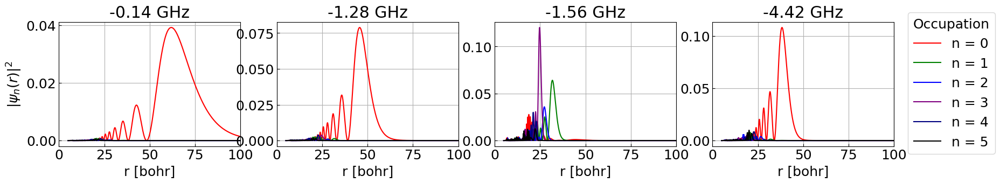

In [ ]:
%matplotlib inline
n_max = 5
take = 4

wave_functions = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_wave_functions_n_max_10_scaling_0_93_0_85.json", n_max + 1)

fig, axes = utility.plot_many(1, take, shape = (5 * take, 3))
axes[0].set_ylabel(r"$|\psi_n(r)|^2$")

for i, (n, wave) in itertools.islice(enumerate(wave_functions.items()), take):
    for j in range(wave.values.shape[1]):
        axes[i].plot(wave.distances, wave.values[:, j] ** 2, color = colors[j])

    axes[i].set_xlabel("r [bohr]")
    axes[i].set_title(f"{wave.energy:.2f} GHz")
    axes[i].set_xlim(0, 100)

fig.legend([f"n = {j}" for j in range(n_max + 1)],
           loc='center right', bbox_to_anchor=(1, 0.5),
           title='Occupation');

# fig.savefig(f"{SAVE_PATH}/wave_function_singlet_scaled_n_10.pdf", bbox_inches = "tight")

interactive(children=(IntSlider(value=0, description='scaling_index', max=80), Output()), _dom_classes=('widge…

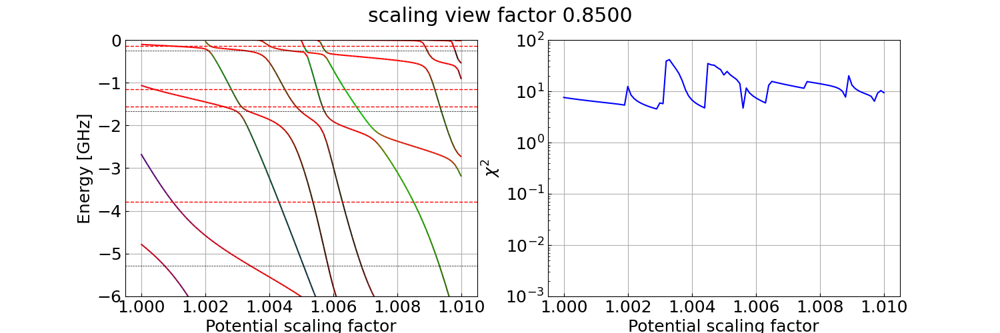

In [ ]:
# triplet n = 10 2d scaling zoomed
%matplotlib widget

bounds_singlet_2d_zoomed = BoundsDependence2D.parse_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_2d_scaling_n_max_10_scaling_1_00.json")
fig, axes = plot_2d(bounds_singlet_2d_zoomed, reference_singlet_scaled_1)

label = "Potential scaling factor"

axes[0].set_ylabel(f"Energy [GHz]")
axes[0].set_xlabel(label)
axes[0].set_ylim(-6, 0)

axes[1].set_yscale("log")
axes[1].set_ylim(1e-3, 1e2)
axes[1].set_ylabel(r"$\chi^2$")
axes[1].set_xlabel(label);

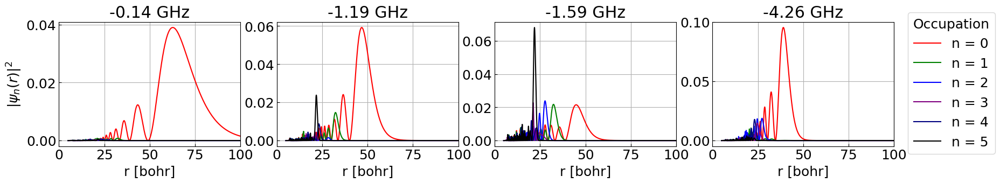

In [ ]:
%matplotlib inline
n_max = 5
take = 4

wave_functions = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_wave_functions_n_max_10_scaling_1_01_1_00.json", n_max + 1)

fig, axes = utility.plot_many(1, take, shape = (5 * take, 3))
axes[0].set_ylabel(r"$|\psi_n(r)|^2$")

for i, (n, wave) in itertools.islice(enumerate(wave_functions.items()), take):
    for j in range(wave.values.shape[1]):
        axes[i].plot(wave.distances, wave.values[:, j] ** 2, color = colors[j])

    axes[i].set_xlabel("r [bohr]")
    axes[i].set_title(f"{wave.energy:.2f} GHz")
    axes[i].set_xlim(0, 100)

fig.legend([f"n = {j}" for j in range(n_max + 1)],
           loc='center right', bbox_to_anchor=(1, 0.5),
           title='Occupation');

# fig.savefig(f"{SAVE_PATH}/wave_function_singlet_scaled_n_10.pdf", bbox_inches = "tight")

# 2D Wavefunction

In [ ]:
from scipy.special import legendre_p_all

def plot_2d_wave(ax: Axes, wave, energy = None, scale = None, n_max = 175, n_angles = 100, log = False, r_max = 50):
    ax.grid(False)
    ax.set_xticks([])
    ax.set_yticks([r_max])

    angles = np.linspace(0, 2 * np.pi, n_angles)
    legendre = np.squeeze(legendre_p_all(n_max, np.cos(angles)))

    distances = wave["r"]

    ax.set_ylim(0, r_max)
    distances = distances[distances < r_max]
    wave_n = wave["coeffs"][:distances.shape[0], :]

    print(distances, distances.shape)

    wave_angles = wave_n @ legendre

    density = wave_angles**2
    if log:
        density = np.log(density)

    ax.contourf(angles, distances, density, levels = 50)
    if energy is not None or scale is not None:
        title = ""
        if energy is not None:
            title += f"energy: {float(energy):.3f} GHz\n"
        if scale is not None:
            title += f"scaling: {float(scale):.3f}"
        ax.set_title(title.strip())

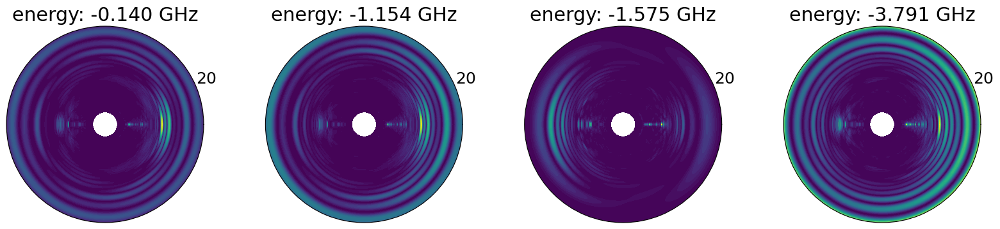

In [ ]:
take = 4
fig, axes = plt.subplots(1, 4, subplot_kw=dict(projection="polar"), figsize = (20, 4))

waves = parse_wavefunction_file(f'{DATA_PATH}/wave_function_singlet_175_scaled.output', 176)

for i, wave in itertools.islice(enumerate(reversed(waves.values())), take):
    plot_2d_wave(axes[i], wave, energy = f"{wave["energy"]}", r_max = 20)

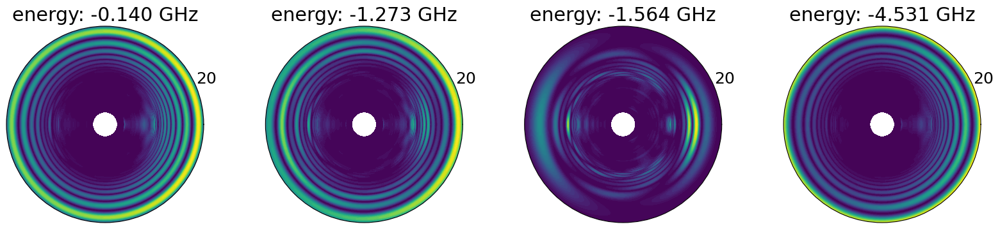

In [ ]:
take = 4
fig, axes = plt.subplots(1, 4, subplot_kw=dict(projection="polar"), figsize = (20, 4))

waves = parse_wavefunction_file(f"{DATA_PATH}/bound_wave_singlet_n_10_scaled_1.0036_v2.output", 11)

for i, wave in itertools.islice(enumerate(reversed(waves.values())), take):
    plot_2d_wave(axes[i], wave, energy = f"{wave["energy"]}", r_max = 20, n_max = 10)

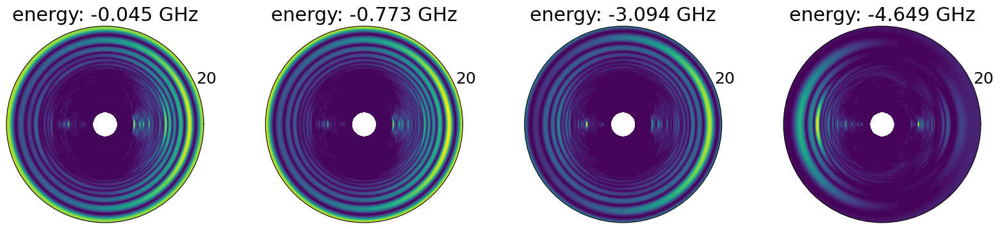

In [ ]:
take = 4
fig, axes = plt.subplots(1, 4, subplot_kw=dict(projection="polar"), figsize = (20, 4))

waves = parse_wavefunction_file(f'{DATA_PATH}/wave_function_triplet_175_scaled.output', 176)

for i, wave in itertools.islice(enumerate(reversed(waves.values())), take):
    plot_2d_wave(axes[i], wave, energy = f"{wave["energy"]}", r_max = 20)

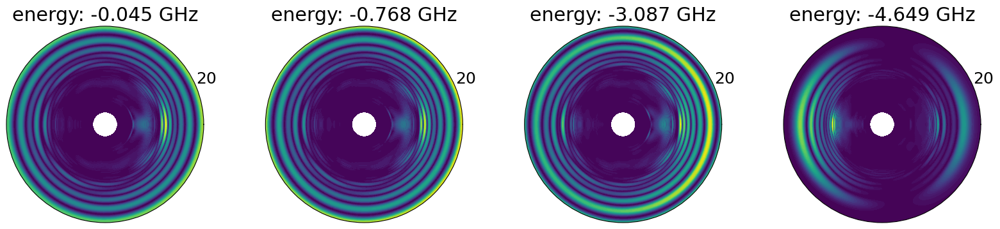

In [ ]:
take = 4
fig, axes = plt.subplots(1, 4, subplot_kw=dict(projection="polar"), figsize = (20, 4))

waves = parse_wavefunction_file(f"{DATA_PATH}/bound_wave_triplet_n_10_scaled_1.007_v2.output", 11)

for i, wave in itertools.islice(enumerate(reversed(waves.values())), take):
    plot_2d_wave(axes[i], wave, energy = f"{wave["energy"]}", r_max = 20, n_max = 10)

# Wave function views

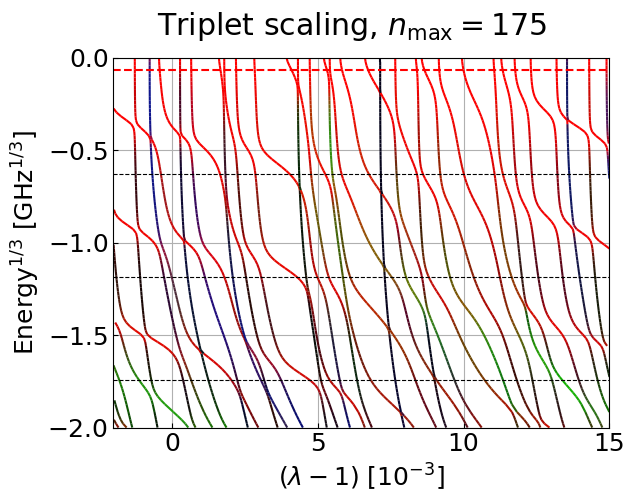

In [ ]:
fig, ax = utility.plot()

def scaling(a, center: float = 1., mult = 1000):
    return (a - center) * mult

plot_bounds(ax, BoundsDependence(f"{DATA_PATH}/field_triplet_n_175_wave_function.dat"), lambda x: scaling(x, 1))

for value in BINS:
    ax.axhline(np.cbrt(value), linestyle="--", color="black", linewidth=0.8)

ax.set_ylim(-2, 0)

ax.set_ylabel(f"Energy$^{{1/3}}$ [GHz$^{{1/3}}$]")
ax.set_xlim(-2, 15)

ax.set_xlabel(r"$(\lambda - 1)$ [$10^{-3}$]")

ax.axhline(np.cbrt(-0.00025193176848), linestyle="--", color="red")

fig.suptitle(r"Triplet scaling, $n_\text{max} = 175$ ");

In [ ]:
spin = "triplet"
suffix = ""
energy_index = 92

file_suffix = f"_scale_{energy_index}{suffix}"
wave_suffix = f"_scale_{energy_index}_field{suffix}"

bounds = FieldOutput(f"{DATA_PATH}/field_{spin}_n_175_wave_function{file_suffix}.output", ScanParameter.PotScaling)
waves = parse_wavefunction_field_file(f"{DATA_PATH}/wave_function_{spin}_n_175{wave_suffix}.output", 176, max_coeff=20)


In [ ]:
for wave, (node, scaled) in zip(waves, bounds.matches[0].states):
    fig, ax = utility.plot()
    ax.set_ylabel(r"$|\psi_n(r)|^2$")
    ax.plot(wave["r"], wave["coeffs"]**2)

    ax.set_xlabel("R")
    ax.set_title(f"scaling = {scaling(scaled):.2f} ")
    ax.set_xlim(0, 200)
    ax.legend([f"n = {j}" for j in range(5)], loc = "upper right")
    
# fig.savefig(f"{SAVE_PATH}/wave_function_triplet_n_10_scaled_0,60.pdf", bbox_inches="tight")

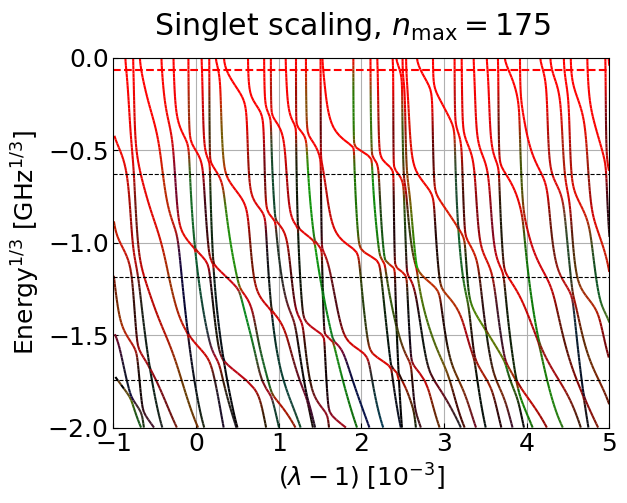

In [ ]:
fig, ax = utility.plot()

def scaling(a, center: float = 1., mult = 1000):
    return (a - center) * mult

plot_bounds(ax, BoundsDependence(f"{DATA_PATH}/field_singlet_n_175_wave_function.dat"), lambda x: scaling(x, 1))

for value in BINS:
    ax.axhline(np.cbrt(value), linestyle="--", color="black", linewidth=0.8)

ax.set_ylim(-2, 0)

ax.set_ylabel(f"Energy$^{{1/3}}$ [GHz$^{{1/3}}$]")
ax.set_xlim(-1, 5)

ax.set_xlabel(r"$(\lambda - 1)$ [$10^{-3}$]")

ax.axhline(np.cbrt(-0.00025193176848), linestyle="--", color="red")

fig.suptitle(r"Singlet scaling, $n_\text{max} = 175$ ");

In [ ]:
from py_common.aggregate_outputs import *
from py_common.wave_function import *

spin = "singlet"
suffix = ""
energy_index = 92

file_suffix = f"_scale_{energy_index}{suffix}"
wave_suffix = f"_scale_{energy_index}_field{suffix}"

bounds = FieldOutput(f"{DATA_PATH}/field_{spin}_n_175_wave_function{file_suffix}.output", ScanParameter.PotScaling)
waves = parse_wavefunction_field_file(f"{DATA_PATH}/wave_function_{spin}_n_175{wave_suffix}.output", 176, max_coeff=20)


In [ ]:
for wave, (node, scaled) in zip(waves, bounds.matches[0].states):
    fig, ax = utility.plot()
    ax.set_ylabel(r"$|\psi_n(r)|^2$")
    ax.plot(wave["r"], wave["coeffs"]**2)

    ax.set_xlabel("R")
    ax.set_title(f"scaling = {scaling(scaled):.2f} ")
    ax.set_xlim(0, 200)
    ax.legend([f"n = {j}" for j in range(5)], loc = "upper right")
    
# fig.savefig(f"{SAVE_PATH}/wave_function_triplet_n_10_scaled_0,60.pdf", bbox_inches="tight")

# chaos

In [ ]:
lambda_min = 0.6
lambda_max = 1.4
lambdas = np.linspace(lambda_min, lambda_max, 1000)

bounds = BoundsDependence.parse_json(f"{DATA_PATH}/SrF_Rb_bounds_triplet_scaling_full_n_max_10_long.json", (lambda_min, lambda_max))

In [ ]:
scalings = np.unique(bounds.data[:, 0])

lower_diffs = []
upper_diffs = []

for scaling in scalings:
    mask = bounds.data[:, 0] == scaling
    energies = bounds.data[mask, 2]

    diff = np.abs(energies[:-1] - energies[1:])
    if scaling < 1:
        lower_diffs.extend(diff)
    else:
        upper_diffs.extend(diff)


lower bins [5.61620422e-01 2.91400930e+03 3.87802990e-01]
upper bins [4.77421630e-01 3.40093226e+03 4.64220727e-01]


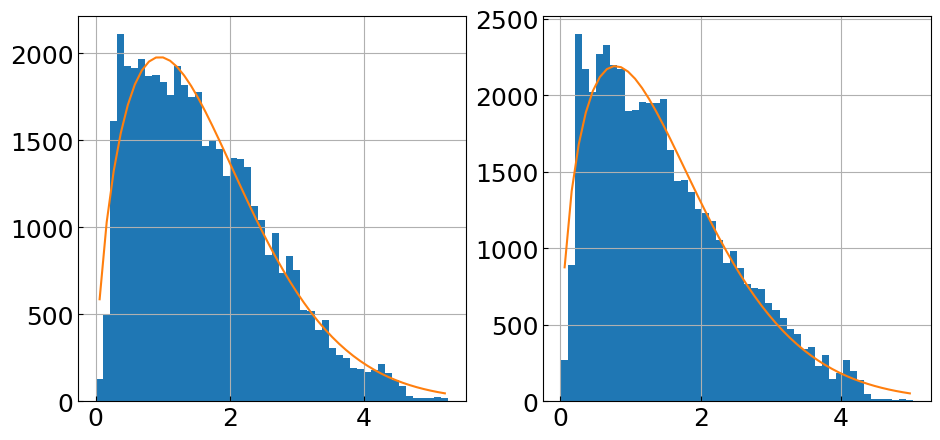

In [ ]:
from scipy.optimize import curve_fit

def brody(x, eta, a, alpha):
    return a * np.pow(x, eta) * np.exp(-alpha * np.pow(x, eta + 1))

fig, axes = utility.plot_many(1, 2, shape=(11, 5))
lower_n, lower_bins, _ = axes[0].hist(lower_diffs, bins = 50)
upper_n, upper_bins, _ = axes[1].hist(upper_diffs, bins = 50)

lower_bins = (lower_bins + np.roll(lower_bins, -1))[:-1] / 2
upper_bins = (upper_bins + np.roll(upper_bins, -1))[:-1] / 2

p, err = curve_fit(brody, lower_bins, lower_n, (1, 5e3, 1))
print("lower bins", p)
axes[0].plot(lower_bins, brody(lower_bins, *p))

p, err = curve_fit(brody, upper_bins, upper_n, (1, 5e3, 1))
print("upper bins", p)
axes[1].plot(upper_bins, brody(upper_bins, *p))

pass

# plots

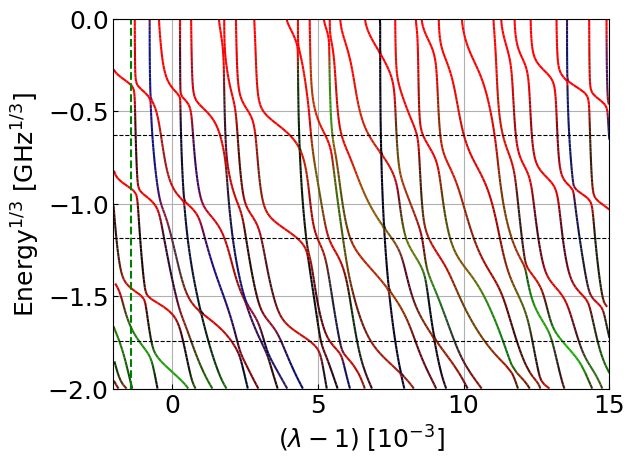

In [ ]:
fig, ax = utility.plot()

def scaling(a, center: float = 1., mult = 1000):
    return (a - center) * mult

bounds = BoundsDependence(f"{DATA_PATH}/field_triplet_n_175_wave_function.dat")
plot_bounds(ax, bounds, scaling)

for value in BINS:
    ax.axhline(np.cbrt(value), linestyle="--", color="black", linewidth=0.8)

ax.set_ylim(-2, 0)

ax.set_ylabel(f"Energy$^{{1/3}}$ [GHz$^{{1/3}}$]")
ax.set_xlim(-2, 15)

ax.set_xlabel(r"$(\lambda - 1)$ [$10^{-3}$]")

ax.axvline(scaling(0.9986), linestyle="--", color="green")

# fig.savefig(f"{SAVE_PATH}/bound_triplet_n_175_scaling.pdf", bbox_inches = "tight")

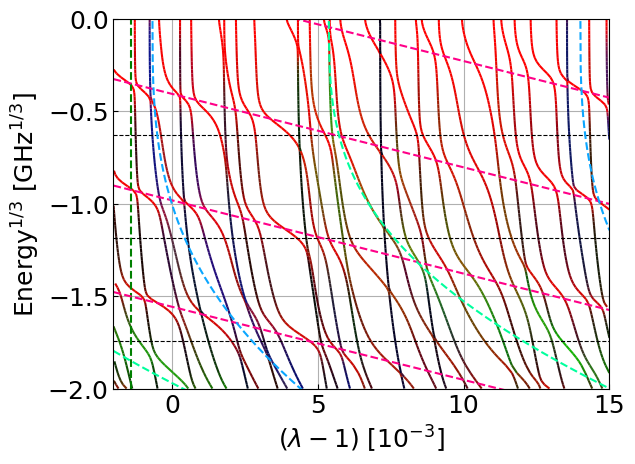

In [ ]:
fig_c: Figure = pickle.loads(pickle.dumps(fig))
ax_c = fig_c.axes[0]

lambdas = np.linspace(1 - 2e-3, 1 + 15e-3, 1000)
levels = WKBLevels(80, ROT_CONST, 0.0072, (lambdas[0], lambdas[-1]), (-2, 0))

levels.add_level_cbrt(0, (1 + 5e-3, -1.18))
levels.add_level_cbrt(1, (1 + 5.5e-3, -0.5))
levels.add_level_cbrt(2, (1, -1))

for l in levels.levels:
    ax_c.plot(scaling(lambdas), l.levels_cbrt(lambdas), linestyle = "--", color = n_colors[l.n])

# fig_c.savefig(f"{SAVE_PATH}/bound_triplet_n_175_scaling_overlines.pdf", bbox_inches = "tight")

fig_c

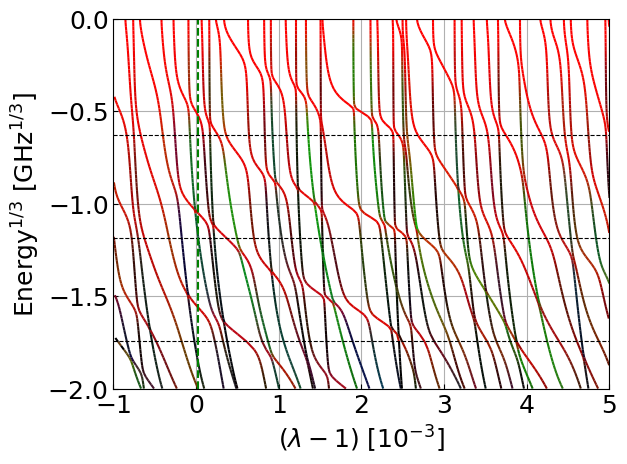

In [3]:
fig, ax = utility.plot()

def scaling(a, center: float = 1., mult = 1000):
    return (a - center) * mult

bounds = BoundsDependence(f"{DATA_PATH}/field_singlet_n_175_wave_function.dat")
plot_bounds(ax, bounds, scaling)

for value in BINS:
    ax.axhline(np.cbrt(value), linestyle="--", color="black", linewidth=0.8)

ax.set_ylim(-2, 0)

ax.set_ylabel(f"Energy$^{{1/3}}$ [GHz$^{{1/3}}$]")
ax.set_xlim(-1, 5)

ax.set_xlabel(r"$(\lambda - 1)$ [$10^{-3}$]")

ax.axvline(scaling(1.00002), linestyle="--", color="green")

fig.savefig(f"{SAVE_PATH}/bound_singlet_n_175_scaling.pdf", bbox_inches = "tight")

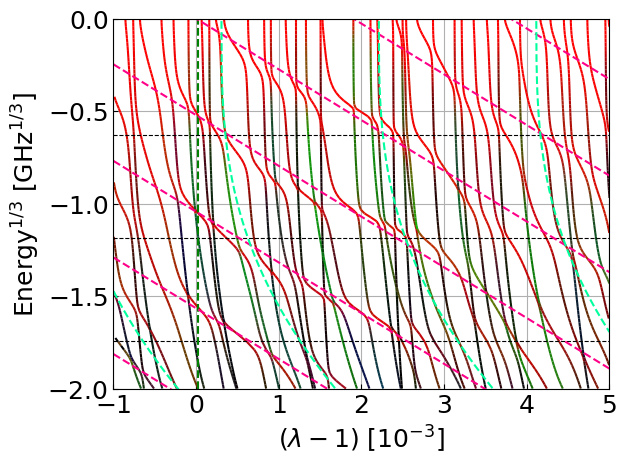

In [ ]:
fig_c: Figure = pickle.loads(pickle.dumps(fig))
ax_c = fig_c.axes[0]

lambdas = np.linspace(1 - 1e-3, 1 + 5e-3, 1000)
levels = WKBLevels(550, ROT_CONST, 0.00095, (lambdas[0], lambdas[-1]), (-2, 0))

levels.add_level_cbrt(0, (1 + 2e-3, -1.07))
levels.add_level_cbrt(1, (1 + 0.5e-3, -1.))

for l in levels.levels:
    ax_c.plot(scaling(lambdas), l.levels_cbrt(lambdas), linestyle = "--", color = n_colors[l.n])

# fig_c.savefig(f"{SAVE_PATH}/bound_singlet_n_175_scaling_overlines.pdf", bbox_inches = "tight")

fig_c

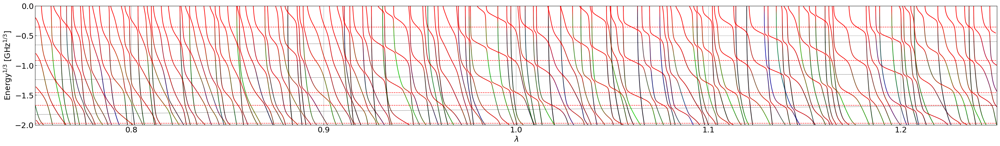

In [15]:
fig, ax = utility.plot(shape = (40, 5))

lambda_min = 0.75
lambda_max = 1.25
lambdas = np.linspace(lambda_min, lambda_max, 1000)

bounds = BoundsDependence.parse_field_json(f"{DATA_PATH}/SrF_Rb_field_triplet_scaling_full_n_max_10_long.json", (lambda_min, lambda_max))

plot_bounds(ax, bounds)

for b in reference_triplet_scaled_1:
    ax.axhline(np.cbrt(b), color = "red", linestyle="--", linewidth=1)

for b in BINS:
    ax.plot(lambdas, np.cbrt(b / np.sqrt(lambdas)), color = "black", linestyle="--", linewidth=0.5)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda$")
ax.set_ylim(-2, 0);
ax.set_xlim(lambda_min, lambda_max);

fig.savefig(f"{SAVE_PATH}/SrF_Rb_triplet_n_10_scaling.pdf", bbox_inches = "tight")

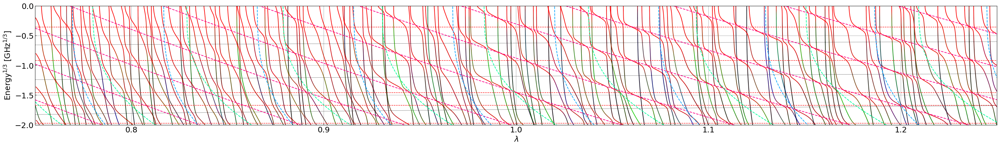

In [16]:
fig_c: Figure = pickle.loads(pickle.dumps(fig))
ax_c: Axes = fig_c.axes[0]

levels = WKBLevels(21, ROT_CONST, 0.0273, (0.6, 1.4), (-2, 0))

levels.add_level_cbrt(0, (1, -0.88))
levels.add_level_cbrt(1, (0.985, -0.6), spacing = 0.026)
levels.add_level_cbrt(2, (1.125, -1), spacing = 0.025)

for l in levels.levels:
    ax_c.plot(lambdas, l.levels_cbrt(lambdas), linestyle = "--", color = n_colors[l.n])

fig_c.savefig(f"{SAVE_PATH}/SrF_Rb_triplet_n_10_scaling_overlines.pdf", bbox_inches = "tight")
fig_c

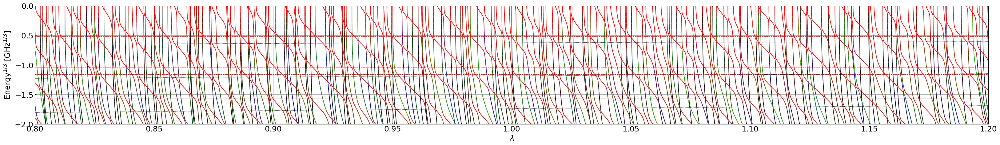

In [17]:
fig, ax = utility.plot(shape = (40, 5))

lambda_min = 0.8
lambda_max = 1.2
lambdas = np.linspace(lambda_min, lambda_max, 1000)

bounds = BoundsDependence.parse_field_json(f"{DATA_PATH}/SrF_Rb_field_singlet_scaling_full_n_max_10_long.json", (lambda_min, lambda_max))

plot_bounds(ax, bounds)

for b in reference_singlet_scaled_1:
    ax.axhline(np.cbrt(b), color = "red", linestyle="--", linewidth=1)

for b in BINS:
    ax.plot(lambdas, np.cbrt(b / np.sqrt(lambdas)), color = "black", linestyle="--", linewidth=0.5)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda$")
ax.set_ylim(-2, 0);
ax.set_xlim(lambda_min, lambda_max);

fig.savefig(f"{SAVE_PATH}/SrF_Rb_singlet_n_10_scaling.pdf", bbox_inches = "tight")


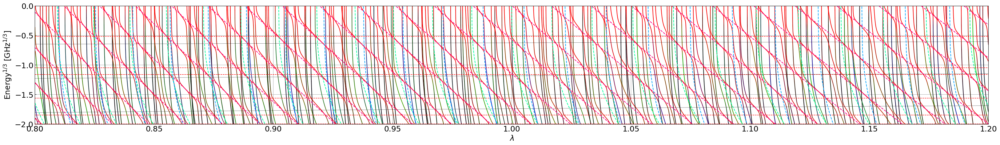

In [18]:
fig_c: Figure = pickle.loads(pickle.dumps(fig))
ax_c: Axes = fig_c.axes[0]

levels = WKBLevels(70, ROT_CONST, 0.00824, (0.8, 1.2), (-2, 0))

levels.add_level_cbrt(0, (1, -1.15))
levels.add_level_cbrt(1, (0.985, -1), spacing = 0.008255)
levels.add_level_cbrt(2, (0.989, -1), spacing = 0.0084)

for l in levels.levels:
    ax_c.plot(lambdas, l.levels_cbrt(lambdas), linestyle = "--", color = n_colors[l.n])

fig_c.savefig(f"{SAVE_PATH}/SrF_Rb_singlet_n_10_scaling_overlines.pdf", bbox_inches = "tight")

fig_c

# ABM

In [ ]:
max_coeff = 175
parsed_singlet = parse_wavefunction_file(f'{DATA_PATH}/wave_function_singlet_175.output', 176, max_coeff = max_coeff)
parsed_singlet_scaled = parse_wavefunction_file(f'{DATA_PATH}/wave_function_singlet_175_scaled.output', 176, max_coeff = max_coeff)
parsed_triplet = parse_wavefunction_file(f'{DATA_PATH}/wave_function_triplet_175.output', 176, max_coeff = max_coeff)
parsed_triplet_scaled = parse_wavefunction_file(f'{DATA_PATH}/wave_function_triplet_175_scaled.output', 176, max_coeff = max_coeff)

In [ ]:
singlet_waves = list(map(lambda x: x[1], reversed(parsed_singlet.items())))
singlet_scaled_waves = list(map(lambda x: x[1], reversed(parsed_singlet_scaled.items())))
triplet_waves = list(map(lambda x: x[1], reversed(parsed_triplet.items())))
triplet_scaled_waves = list(map(lambda x: x[1], reversed(parsed_triplet_scaled.items())))

In [3]:
max_coeff = 175
parsed_singlet_1_00186 = parse_wavefunction_file(f'{DATA_PATH}/wave_function_srf_rb_n_175_singlet_simple_1_00186.output', 176, max_coeff = max_coeff)
parsed_triplet_0_9986 = parse_wavefunction_file(f'{DATA_PATH}/wave_function_srf_rb_n_175_triplet_simple_0_9986.output', 176, max_coeff = max_coeff)
singlet_1_00186_waves = list(map(lambda x: x[1], reversed(parsed_singlet_1_00186.items())))
triplet_0_9986_waves = list(map(lambda x: x[1], reversed(parsed_triplet_0_9986.items())))

In [4]:
import abm_py as abm

rb = abm.HifiProblemBuilder(1, 3)
rb.with_hyperfine_coupling(6.834682610904290 / 2 * GHZ)

srf = abm.HifiProblemBuilder(1, 1)
srf.with_hyperfine_coupling((3.2383e-3 + 1.0096e-3 / 3.) * CMINV)

srf_rb = abm.DoubleHifiProblemBuilder(srf, rb)
srf_rb.with_projection(2)

mag_fields = np.linspace(0, 1000, 500)
states = np.array(srf_rb.build().states_range(mag_fields)) / GHZ

def calc_fc_factors(singlet, triplet):
    return np.trapezoid(np.sum(singlet["coeffs"] * triplet["coeffs"], axis = -1), triplet["r"])

from scipy.interpolate import make_interp_spline
def calc_fc_factors_diff_grid(singlet, triplet):
    spline = make_interp_spline(singlet["r"], singlet["coeffs"])
    singlet_coeffs = spline(triplet["r"])

    return np.trapezoid(np.sum(singlet_coeffs * triplet["coeffs"], axis = -1), triplet["r"])

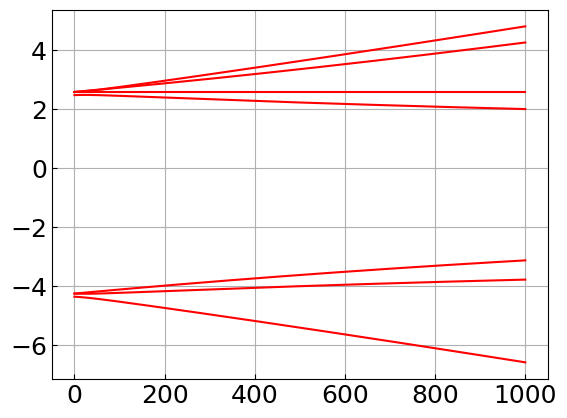

In [ ]:
fig, ax = utility.plot()
ax.plot(mag_fields, states[:, :], color = "red");

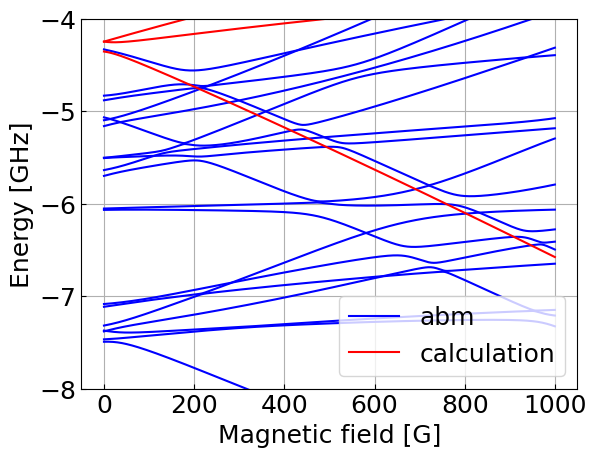

In [ ]:
srf_rb_abm = abm.ABMProblemBuilder(srf, rb)
srf_rb_abm.with_projection(2)

singlet_energies = np.array(list(map(lambda x: x["energy"], singlet_scaled_waves)))[0:7] * GHZ
triplet_energies = np.array(list(map(lambda x: x["energy"], triplet_scaled_waves)))[0:7] * GHZ

fc_factors = np.zeros((singlet_energies.shape[0], triplet_energies.shape[0]))
for i in range(fc_factors.shape[0]):
    for j in range(fc_factors.shape[1]):
        fc_factors[i, j] = calc_fc_factors(singlet_scaled_waves[i], triplet_scaled_waves[j])

srf_rb_abm.with_vibrational(singlet_energies, triplet_energies, fc_factors.flatten())

states_abm = np.array(srf_rb_abm.build().states_range(mag_fields)) / GHZ

fig, ax = utility.plot()
ax.plot(mag_fields, states_abm, color = "blue")
ax.plot(mag_fields, states[:, :], color = "red")

ax.set_ylim(-8, -4)

# bounds_single = BoundsDependence(f"{DATA_PATH}/bound_n_max_175.dat")
# for state in bounds_single.states():
# 	ax.plot(state[:, 0], state[:, 1], color = "red", linestyle = ":")

ax.legend([ax.lines[0], ax.lines[-1]], ["abm", "calculation"], loc = "lower right")
ax.set_xlabel("Magnetic field [G]")
ax.set_ylabel("Energy [GHz]");

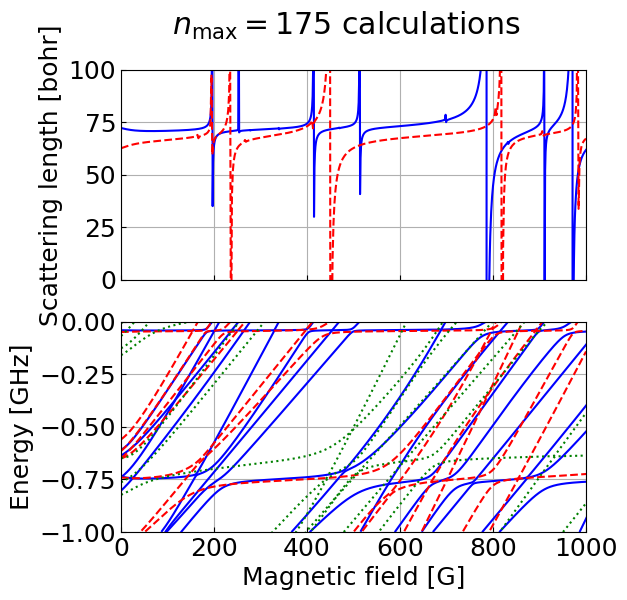

In [ ]:
fig, axes = utility.plot_many(2, 1, shape=(6, 6), sharex=True)

filename = f"{DATA_PATH}/molscat_n_max_175_scaled_1.dat"
data = np.loadtxt(filename, delimiter="\t", skiprows=1)

axes[0].plot(data[:, 1], data[:, 2] * ANGS, color = "blue")

axes[0].set_ylabel(f"Scattering length [bohr]")
axes[0].set_ylim(0, 100);

bounds_single = BoundsDependence(f"{DATA_PATH}/bound_n_max_175_scaled_1.dat")
for state in bounds_single.states():
	axes[1].plot(state[:, 0], state[:, 1], color = "blue")
	
axes[1].set_ylabel(f"Energy [GHz]")
axes[1].set_xlabel("Magnetic field [G]")
axes[1].set_ylim(-1, 0);
axes[1].set_xlim(0, 1000);

scatterings = ScatteringDependence.parse_json(f"{DATA_PATH}/SrF_Rb_scattering_n_max_10_scaled_v1.json")
axes[0].plot(scatterings.parameters, scatterings.s_lengths().real, color = "red", linestyle = "--")

bounds = BoundsDependence.parse_json(f"{DATA_PATH}/SrF_Rb_bound_states_n_max_10_scaled_v1.json")
for state in bounds.states():
	axes[1].plot(state[:, 0], state[:, 1], color = "red", linestyle = "--")
	
axes[1].plot(mag_fields, states_abm - states[:, 0:1], color = "green", linestyle = ":")

# fig.savefig(f"{SAVE_PATH}/feshbach_n_175.pdf", bbox_inches = "tight")
fig.suptitle(r"$n_\text{max} = 175$ calculations");

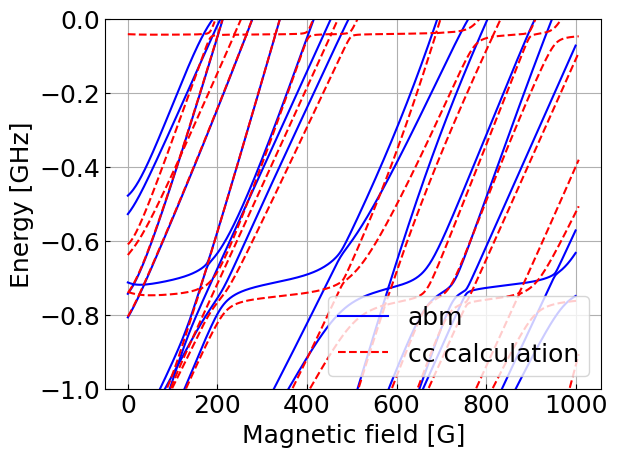

In [ ]:
srf_rb_abm = abm.ABMProblemBuilder(srf, rb)
srf_rb_abm.with_projection(2)

singlet_energies = np.array(list(map(lambda x: x["energy"], singlet_scaled_waves)))[0:7] * GHZ
triplet_energies = np.array(list(map(lambda x: x["energy"], triplet_scaled_waves)))[0:7] * GHZ

fc_factors = np.zeros((singlet_energies.shape[0], triplet_energies.shape[0]))
for i in range(fc_factors.shape[0]):
    for j in range(fc_factors.shape[1]):
        fc_factors[i, j] = calc_fc_factors(singlet_scaled_waves[i], triplet_scaled_waves[j])

srf_rb_abm.with_vibrational(singlet_energies, triplet_energies, fc_factors.flatten())

states_abm = np.array(srf_rb_abm.build().states_range(mag_fields)) / GHZ

fig, ax = utility.plot()
ax.plot(mag_fields, states_abm - states[:, 0:1], color = "blue")

bounds_single = BoundsDependence(f"{DATA_PATH}/bound_n_max_175_scaled_1.dat")
for state in bounds_single.states():
	ax.plot(state[:, 0], state[:, 1], color = "red", linestyle = "--")

ax.set_ylim(-1, 0)
ax.legend([ax.lines[0], ax.lines[-1]], ["abm", "cc calculation"], loc = "lower right")
ax.set_xlabel("Magnetic field [G]")
ax.set_ylabel("Energy [GHz]");

# fig.savefig(f"{SAVE_PATH}/SrF_Rb_n_175_abm.pdf", bbox_inches = "tight")

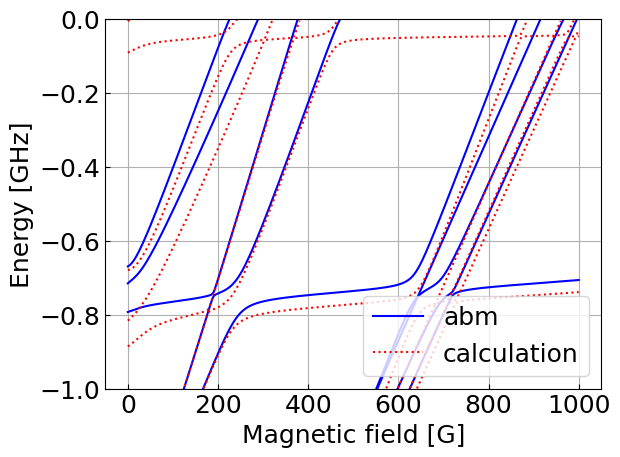

In [ ]:
take = 10

srf_rb_abm = abm.ABMProblemBuilder(srf, rb)
srf_rb_abm.with_projection(2)

singlets = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_wave_functions_n_max_10_morphing_02_long.json")
singlets = list(map(lambda x: x[1].to_dict(), singlets.items()))

triplets = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_triplet_wave_functions_n_max_10_morphing_98_long.json")
triplets = list(map(lambda x: x[1].to_dict(), triplets.items()))

singlet_energies = np.array(list(map(lambda x: x["energy"], singlets)))[0:take] * GHZ
triplet_energies = np.array(list(map(lambda x: x["energy"], triplets)))[0:take] * GHZ

fc_factors = np.zeros((singlet_energies.shape[0], triplet_energies.shape[0]))
for i in range(fc_factors.shape[0]):
    for j in range(fc_factors.shape[1]):
        fc_factors[i, j] = calc_fc_factors_diff_grid(singlets[i], triplets[j])

srf_rb_abm.with_vibrational(singlet_energies, triplet_energies, fc_factors.flatten())

states_abm = np.array(srf_rb_abm.build().states_range(mag_fields)) / GHZ

fig, ax = utility.plot()
ax.plot(mag_fields, states_abm - states[:, 0:1], color = "blue")

bounds_single = BoundsDependence.parse_json(f"{DATA_PATH}/SrF_Rb_bound_states_n_max_10_scaled_v2.json")
for state in bounds_single.states():
	ax.plot(state[:, 0], state[:, 1], color = "red", linestyle = ":")

ax.set_ylim(-1, 0)
ax.legend([ax.lines[0], ax.lines[-1]], ["abm", "calculation"], loc = "lower right")
ax.set_xlabel("Magnetic field [G]")
ax.set_ylabel("Energy [GHz]");

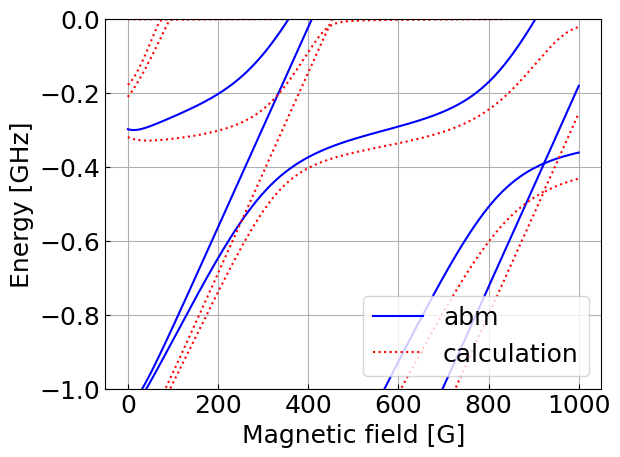

In [ ]:
take = 6

srf_rb_abm = abm.ABMProblemBuilder(srf, rb)
srf_rb_abm.with_projection(2)

singlets = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_wave_functions_n_max_0_v2.json")
singlets = list(map(lambda x: x[1].to_dict(), singlets.items()))

triplets = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_triplet_wave_functions_n_max_0_v2.json")
triplets = list(map(lambda x: x[1].to_dict(), triplets.items()))

singlet_energies = np.array(list(map(lambda x: x["energy"], singlets)))[0:take] * GHZ
triplet_energies = np.array(list(map(lambda x: x["energy"], triplets)))[0:take] * GHZ

fc_factors = np.zeros((singlet_energies.shape[0], triplet_energies.shape[0]))
for i in range(fc_factors.shape[0]):
    for j in range(fc_factors.shape[1]):
        fc_factors[i, j] = calc_fc_factors_diff_grid(singlets[i], triplets[j])

srf_rb_abm.with_vibrational(singlet_energies, triplet_energies, fc_factors.flatten())

states_abm = np.array(srf_rb_abm.build().states_range(mag_fields)) / GHZ

fig, ax = utility.plot()
ax.plot(mag_fields, states_abm - states[:, 0:1], color = "blue")

bounds_single = BoundsDependence.parse_json(f"{DATA_PATH}/SrF_Rb_bound_states_n_max_0_v2.json")
for state in bounds_single.states():
	ax.plot(state[:, 0], state[:, 1], color = "red", linestyle = ":")

ax.set_ylim(-1, 0)
ax.legend([ax.lines[0], ax.lines[-1]], ["abm", "calculation"], loc = "lower right")
ax.set_xlabel("Magnetic field [G]")
ax.set_ylabel("Energy [GHz]");

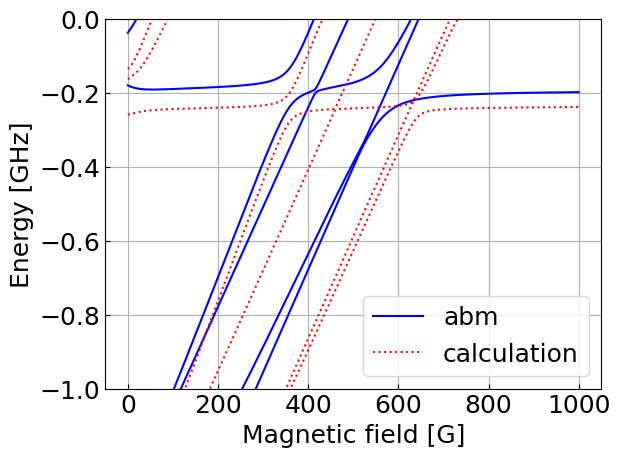

In [ ]:
take = 20

srf_rb_abm = abm.ABMProblemBuilder(srf, rb)
srf_rb_abm.with_projection(2)

singlets = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_wave_functions_n_max_1_v2.json")
singlets = list(map(lambda x: x[1].to_dict(), singlets.items()))

triplets = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_triplet_wave_functions_n_max_1_v2.json")
triplets = list(map(lambda x: x[1].to_dict(), triplets.items()))

singlet_energies = np.array(list(map(lambda x: x["energy"], singlets)))[0:take] * GHZ
triplet_energies = np.array(list(map(lambda x: x["energy"], triplets)))[0:take] * GHZ

fc_factors = np.zeros((singlet_energies.shape[0], triplet_energies.shape[0]))
for i in range(fc_factors.shape[0]):
    for j in range(fc_factors.shape[1]):
        fc_factors[i, j] = calc_fc_factors_diff_grid(singlets[i], triplets[j])

srf_rb_abm.with_vibrational(singlet_energies, triplet_energies, fc_factors.flatten())

states_abm = np.array(srf_rb_abm.build().states_range(mag_fields)) / GHZ

fig, ax = utility.plot()
ax.plot(mag_fields, states_abm - states[:, 0:1], color = "blue")

bounds_single = BoundsDependence.parse_json(f"{DATA_PATH}/SrF_Rb_bound_states_n_max_1_v2.json")
for state in bounds_single.states():
	ax.plot(state[:, 0], state[:, 1], color = "red", linestyle = ":")

ax.set_ylim(-1, 0)
ax.legend([ax.lines[0], ax.lines[-1]], ["abm", "calculation"], loc = "lower right")
ax.set_xlabel("Magnetic field [G]")
ax.set_ylabel("Energy [GHz]");

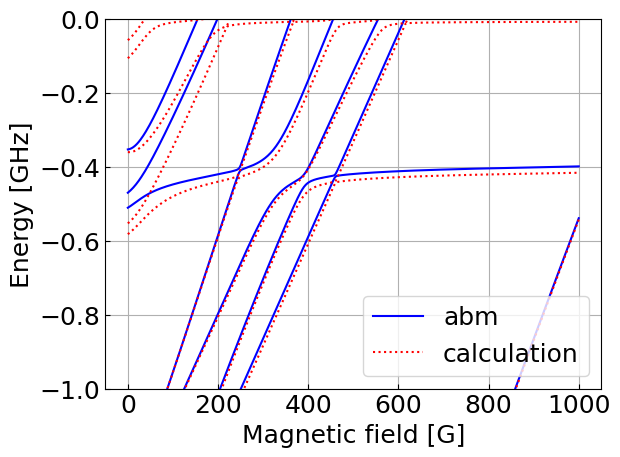

In [ ]:
take = 30

srf_rb_abm = abm.ABMProblemBuilder(srf, rb)
srf_rb_abm.with_projection(2)

singlets = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_wave_functions_n_max_2_v2.json")
singlets = list(map(lambda x: x[1].to_dict(), singlets.items()))

triplets = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_triplet_wave_functions_n_max_2_v2.json")
triplets = list(map(lambda x: x[1].to_dict(), triplets.items()))

singlet_energies = np.array(list(map(lambda x: x["energy"], singlets)))[0:take] * GHZ
triplet_energies = np.array(list(map(lambda x: x["energy"], triplets)))[0:take] * GHZ

fc_factors = np.zeros((singlet_energies.shape[0], triplet_energies.shape[0]))
for i in range(fc_factors.shape[0]):
    for j in range(fc_factors.shape[1]):
        fc_factors[i, j] = calc_fc_factors_diff_grid(singlets[i], triplets[j])

srf_rb_abm.with_vibrational(singlet_energies, triplet_energies, fc_factors.flatten())

states_abm = np.array(srf_rb_abm.build().states_range(mag_fields)) / GHZ

fig, ax = utility.plot()
ax.plot(mag_fields, states_abm - states[:, 0:1], color = "blue")

bounds_single = BoundsDependence.parse_json(f"{DATA_PATH}/SrF_Rb_bound_states_n_max_2_v2.json")
for state in bounds_single.states():
	ax.plot(state[:, 0], state[:, 1], color = "red", linestyle = ":")

ax.set_ylim(-1, 0)
ax.legend([ax.lines[0], ax.lines[-1]], ["abm", "calculation"], loc = "lower right")
ax.set_xlabel("Magnetic field [G]")
ax.set_ylabel("Energy [GHz]");

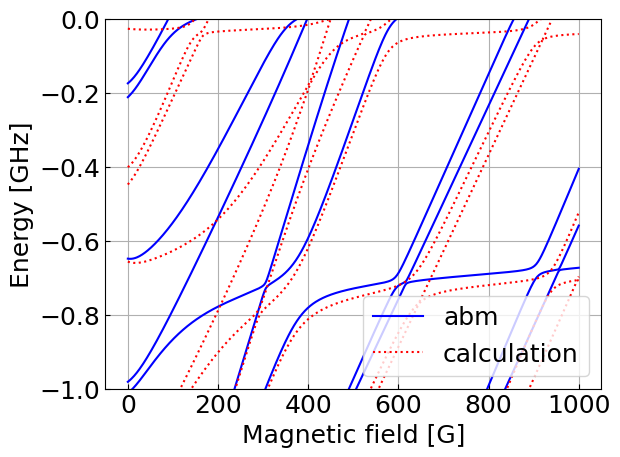

In [ ]:
take = 20

srf_rb_abm = abm.ABMProblemBuilder(srf, rb)
srf_rb_abm.with_projection(2)

singlets = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_wave_functions_n_max_5_v2.json")
singlets = list(map(lambda x: x[1].to_dict(), singlets.items()))

triplets = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_triplet_wave_functions_n_max_5_v2.json")
triplets = list(map(lambda x: x[1].to_dict(), triplets.items()))

singlet_energies = np.array(list(map(lambda x: x["energy"], singlets)))[0:take] * GHZ
triplet_energies = np.array(list(map(lambda x: x["energy"], triplets)))[0:take] * GHZ

fc_factors = np.zeros((singlet_energies.shape[0], triplet_energies.shape[0]))
for i in range(fc_factors.shape[0]):
    for j in range(fc_factors.shape[1]):
        fc_factors[i, j] = calc_fc_factors_diff_grid(singlets[i], triplets[j])

srf_rb_abm.with_vibrational(singlet_energies, triplet_energies, fc_factors.flatten())

states_abm = np.array(srf_rb_abm.build().states_range(mag_fields)) / GHZ

fig, ax = utility.plot()
ax.plot(mag_fields, states_abm - states[:, 0:1], color = "blue")

bounds_single = BoundsDependence.parse_json(f"{DATA_PATH}/SrF_Rb_bound_states_n_max_5_v2.json")
for state in bounds_single.states():
	ax.plot(state[:, 0], state[:, 1], color = "red", linestyle = ":")

ax.set_ylim(-1, 0)
ax.legend([ax.lines[0], ax.lines[-1]], ["abm", "calculation"], loc = "lower right")
ax.set_xlabel("Magnetic field [G]")
ax.set_ylabel("Energy [GHz]");

In [ ]:
import abm_py as abm

rb = abm.HifiProblemBuilder(1, 3)
rb.with_hyperfine_coupling(0.034682610904290 / 2. * GHZ)

srf = abm.HifiProblemBuilder(1, 1)
srf.with_hyperfine_coupling((3.2383e-3 + 1.0096e-3 / 3.) * CMINV)

srf_rb = abm.DoubleHifiProblemBuilder(srf, rb)
srf_rb.with_projection(2)

mag_fields = np.linspace(0, 1000, 500)
states = np.array(srf_rb.build().states_range(mag_fields)) / GHZ

def calc_fc_factors(singlet, triplet):
    return np.trapezoid(np.sum(singlet["coeffs"] * triplet["coeffs"], axis = -1), triplet["r"])

from scipy.interpolate import make_interp_spline
def calc_fc_factors_diff_grid(singlet, triplet):
    spline = make_interp_spline(singlet["r"], singlet["coeffs"])
    singlet_coeffs = spline(triplet["r"])

    return np.trapezoid(np.sum(singlet_coeffs * triplet["coeffs"], axis = -1), triplet["r"])

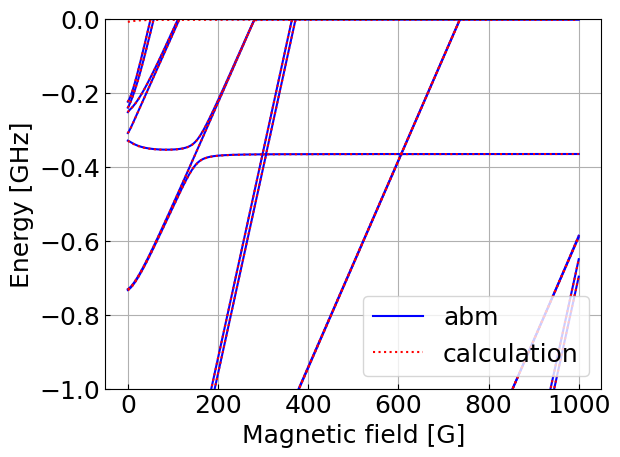

In [ ]:
take = 6

srf_rb_abm = abm.ABMProblemBuilder(srf, rb)
srf_rb_abm.with_projection(2)

singlets = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_wave_functions_n_max_0_v2.json")
singlets = list(map(lambda x: x[1].to_dict(), singlets.items()))

triplets = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_triplet_wave_functions_n_max_0_v2.json")
triplets = list(map(lambda x: x[1].to_dict(), triplets.items()))

singlet_energies = np.array(list(map(lambda x: x["energy"], singlets)))[0:take] * GHZ
triplet_energies = np.array(list(map(lambda x: x["energy"], triplets)))[0:take] * GHZ

fc_factors = np.zeros((singlet_energies.shape[0], triplet_energies.shape[0]))
for i in range(fc_factors.shape[0]):
    for j in range(fc_factors.shape[1]):
        fc_factors[i, j] = calc_fc_factors_diff_grid(singlets[i], triplets[j])

srf_rb_abm.with_vibrational(singlet_energies, triplet_energies, fc_factors.flatten())

states_abm = np.array(srf_rb_abm.build().states_range(mag_fields)) / GHZ

fig, ax = utility.plot()
ax.plot(mag_fields, states_abm - states[:, 0:1], color = "blue")

bounds_single = BoundsDependence.parse_json(f"{DATA_PATH}/SrF_Rb_bound_states_n_max_0_low_hifi.json")
for state in bounds_single.states():
	ax.plot(state[:, 0], state[:, 1], color = "red", linestyle = ":")

ax.set_ylim(-1, 0)
ax.legend([ax.lines[0], ax.lines[-1]], ["abm", "calculation"], loc = "lower right")
ax.set_xlabel("Magnetic field [G]")
ax.set_ylabel("Energy [GHz]");

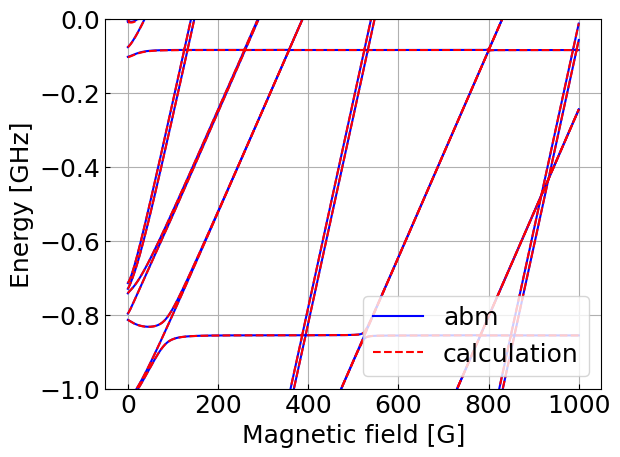

In [ ]:
take = 6

srf_rb_abm = abm.ABMProblemBuilder(srf, rb)
srf_rb_abm.with_projection(2)

singlets = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_wave_functions_n_max_10_v2.json")
singlets = list(map(lambda x: x[1].to_dict(), singlets.items()))

triplets = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_triplet_wave_functions_n_max_10_v2.json")
triplets = list(map(lambda x: x[1].to_dict(), triplets.items()))

singlet_energies = np.array(list(map(lambda x: x["energy"], singlets)))[0:take] * GHZ
triplet_energies = np.array(list(map(lambda x: x["energy"], triplets)))[0:take] * GHZ

fc_factors = np.zeros((singlet_energies.shape[0], triplet_energies.shape[0]))
for i in range(fc_factors.shape[0]):
    for j in range(fc_factors.shape[1]):
        fc_factors[i, j] = calc_fc_factors_diff_grid(singlets[i], triplets[j])

srf_rb_abm.with_vibrational(singlet_energies, triplet_energies, fc_factors.flatten())

states_abm = np.array(srf_rb_abm.build().states_range(mag_fields)) / GHZ

fig, ax = utility.plot()
ax.plot(mag_fields, states_abm - states[:, 0:1], color = "blue")

bounds_single = BoundsDependence.parse_json(f"{DATA_PATH}/SrF_Rb_bound_states_n_max_10_low_hifi.json")
for state in bounds_single.states():
	ax.plot(state[:, 0], state[:, 1], color = "red", linestyle = "--")

ax.set_ylim(-1, 0)
ax.legend([ax.lines[0], ax.lines[-1]], ["abm", "calculation"], loc = "lower right")
ax.set_xlabel("Magnetic field [G]")
ax.set_ylabel("Energy [GHz]");

# fig.savefig(f"{SAVE_PATH}/SrF_Rb_n_175_abm_reduced_hifi.pdf", bbox_inches = "tight")

# Non adiabatic

(-20.0, 20.0)

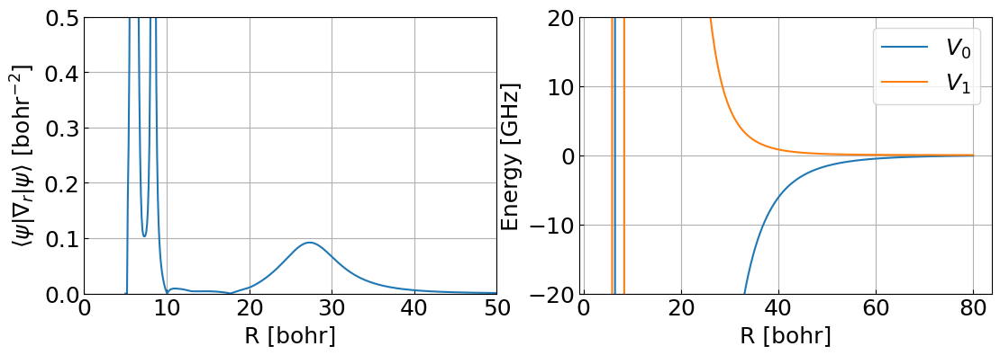

In [ ]:
data = utility.load(f"{DATA_PATH}/srf_rb_singlet_non_adiabatic_n_1.dat")

fig, axes = utility.plot_many(1, 2, shape = (13, 4))
axes[0].plot(data[:, 0], data[:, 1:]);
axes[0].set_xlabel("R [bohr]")
axes[0].set_xlim(0, 80)
axes[0].set_ylabel(r"$\langle\psi|\nabla_r|\psi\rangle$ [bohr$^{-2}$]")

data = utility.load(f"{DATA_PATH}/SrF_Rb_singlet_dec_interpolated.dat")
scalings = data[:, 0]
values_legendre = data[:, 1:3]

axes[1].plot(scalings, values_legendre / GHZ)
axes[1].legend(["$V_0$", "$V_1$"])
axes[1].set_xlabel("R [bohr]")
axes[1].set_ylabel(r"Energy [GHz]")

axes[0].set_xlim(0, 50)
axes[0].set_ylim(0, 0.5)
axes[1].set_ylim(-20, 20)

(-20.0, 20.0)

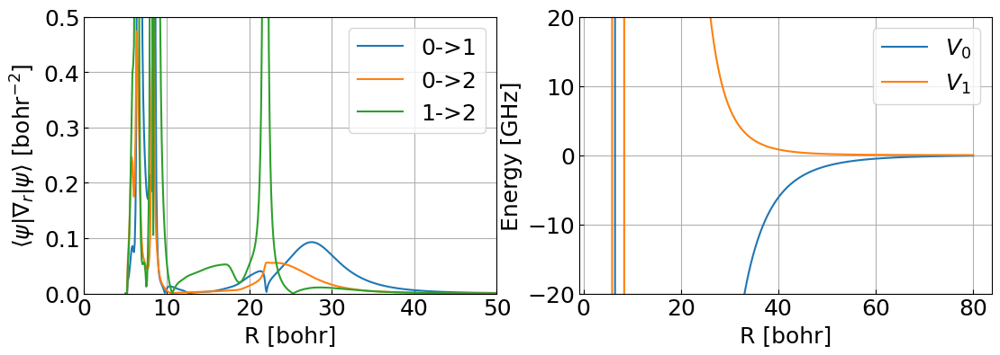

In [ ]:
data = utility.load(f"{DATA_PATH}/srf_rb_singlet_non_adiabatic_n_2.dat")

fig, axes = utility.plot_many(1, 2, shape = (13, 4))
axes[0].plot(data[:, 0], data[:, 1:], label = ["0->1", "0->2", "1->2"])
axes[0].legend()
axes[0].set_xlabel("R [bohr]")
axes[0].set_ylabel(r"$\langle\psi|\nabla_r|\psi\rangle$ [bohr$^{-2}$]")

data = utility.load(f"{DATA_PATH}/SrF_Rb_singlet_dec_interpolated.dat")
scalings = data[:, 0]
values_legendre = data[:, 1:3]

axes[1].plot(scalings, values_legendre / GHZ)
axes[1].legend(["$V_0$", "$V_1$"])
axes[1].set_xlabel("R [bohr]")
axes[1].set_ylabel(r"Energy [GHz]")

axes[0].set_xlim(0, 50)
axes[0].set_ylim(0, 0.5)
axes[1].set_ylim(-20, 20)

(-20.0, 20.0)

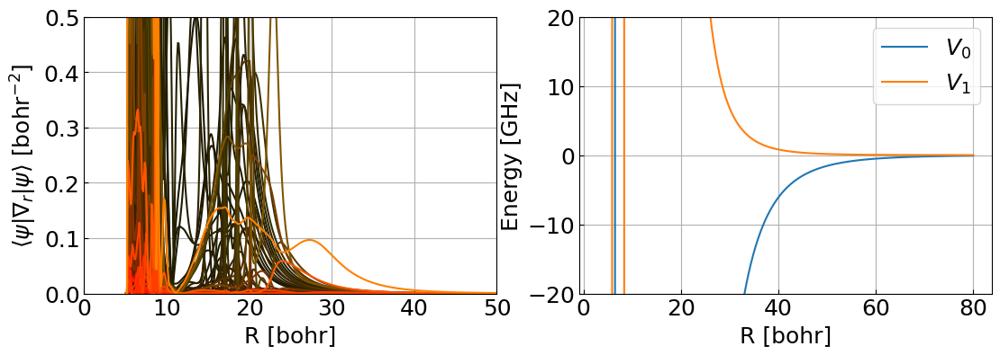

In [ ]:
data = utility.load(f"{DATA_PATH}/srf_rb_singlet_non_adiabatic_n_10.dat")

colors = np.array([(1 / (i + 1), (1 / (j + 1)), 0) for i in range(11) for j in range(i + 1, 11)])
fig, axes = utility.plot_many(1, 2, shape = (13, 4))

for i, c in reversed(list(enumerate(colors))):
    axes[0].plot(data[:, 0], data[:, i + 1], color = c)

axes[0].set_xlabel("R [bohr]")
axes[0].set_xlim(0, 80)
axes[0].set_ylabel(r"$\langle\psi|\nabla_r|\psi\rangle$ [bohr$^{-2}$]")

data = utility.load(f"{DATA_PATH}/SrF_Rb_singlet_dec_interpolated.dat")
scalings = data[:, 0]
values_legendre = data[:, 1:3]

axes[1].plot(scalings, values_legendre / GHZ)
axes[1].legend(["$V_0$", "$V_1$"])
axes[1].set_xlabel("R [bohr]")
axes[1].set_ylabel(r"Energy [GHz]")

axes[0].set_xlim(0, 50)
axes[0].set_ylim(0, 0.5)
axes[1].set_ylim(-20, 20)

(-20.0, 20.0)

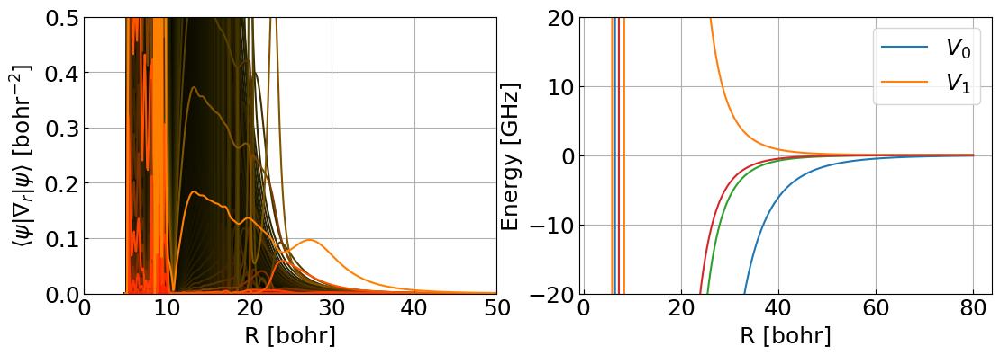

In [ ]:
data = utility.load(f"{DATA_PATH}/srf_rb_singlet_non_adiabatic_n_175.dat")

colors = np.array([(1 / (i + 1), (1 / (j + 1)), 0) for i in range(176) for j in range(i + 1, 176)])
fig, axes = utility.plot_many(1, 2, shape = (13, 4))
for i, c in reversed(list(enumerate(colors))):
    axes[0].plot(data[:, 0], data[:, i + 1], color = c)
axes[0].set_xlabel("R [bohr]")
axes[0].set_xlim(0, 80)
axes[0].set_ylabel(r"$\langle\psi|\nabla_r|\psi\rangle$ [bohr$^{-2}$]")

data = utility.load(f"{DATA_PATH}/SrF_Rb_singlet_dec_interpolated.dat")
scalings = data[:, 0]
values_legendre = data[:, 1:5]

axes[1].plot(scalings, values_legendre / GHZ)
axes[1].legend(["$V_0$", "$V_1$"])
axes[1].set_xlabel("R [bohr]")
axes[1].set_ylabel(r"Energy [GHz]")

axes[0].set_xlim(0, 50)
axes[0].set_ylim(0, 0.5)
axes[1].set_ylim(-20, 20)

(-20.0, 20.0)

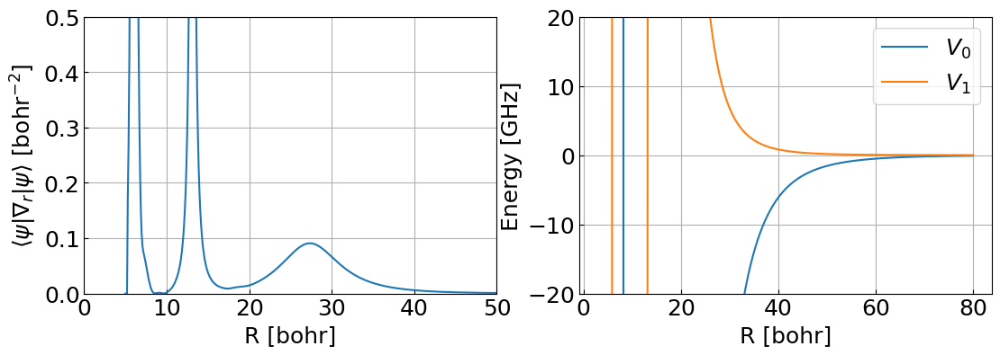

In [ ]:
data = utility.load(f"{DATA_PATH}/srf_rb_triplet_non_adiabatic_n_1.dat")

fig, axes = utility.plot_many(1, 2, shape = (13, 4))
axes[0].plot(data[:, 0], data[:, 1:]);
axes[0].set_xlabel("R [bohr]")
axes[0].set_xlim(0, 80)
axes[0].set_ylabel(r"$\langle\psi|\nabla_r|\psi\rangle$ [bohr$^{-2}$]")

data = utility.load(f"{DATA_PATH}/SrF_Rb_triplet_dec_interpolated.dat")
scalings = data[:, 0]
values_legendre = data[:, 1:3]

axes[1].plot(scalings, values_legendre / GHZ)
axes[1].legend(["$V_0$", "$V_1$"])
axes[1].set_xlabel("R [bohr]")
axes[1].set_ylabel(r"Energy [GHz]")

axes[0].set_xlim(0, 50)
axes[0].set_ylim(0, 0.5)
axes[1].set_ylim(-20, 20)

(-20.0, 20.0)

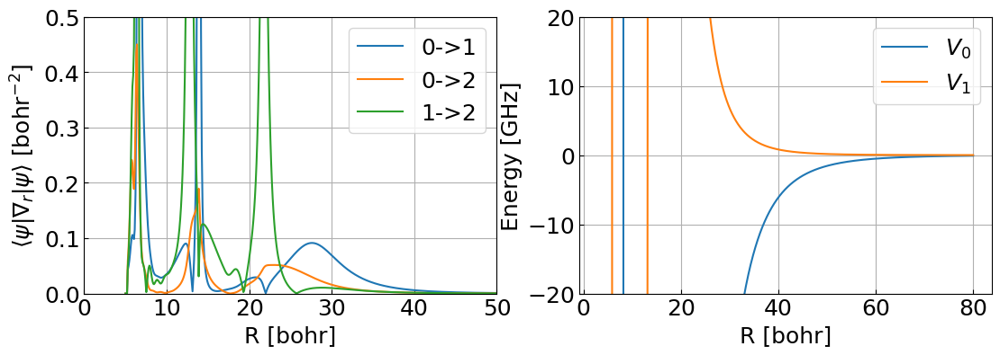

In [ ]:
data = utility.load(f"{DATA_PATH}/srf_rb_triplet_non_adiabatic_n_2.dat")

fig, axes = utility.plot_many(1, 2, shape = (13, 4))
axes[0].plot(data[:, 0], data[:, 1:], label = ["0->1", "0->2", "1->2"])
axes[0].legend()
axes[0].set_xlabel("R [bohr]")
axes[0].set_ylabel(r"$\langle\psi|\nabla_r|\psi\rangle$ [bohr$^{-2}$]")

data = utility.load(f"{DATA_PATH}/SrF_Rb_triplet_dec_interpolated.dat")
scalings = data[:, 0]
values_legendre = data[:, 1:3]

axes[1].plot(scalings, values_legendre / GHZ)
axes[1].legend(["$V_0$", "$V_1$"])
axes[1].set_xlabel("R [bohr]")
axes[1].set_ylabel(r"Energy [GHz]")

axes[0].set_xlim(0, 50)
axes[0].set_ylim(0, 0.5)
axes[1].set_ylim(-20, 20)

(-20.0, 20.0)

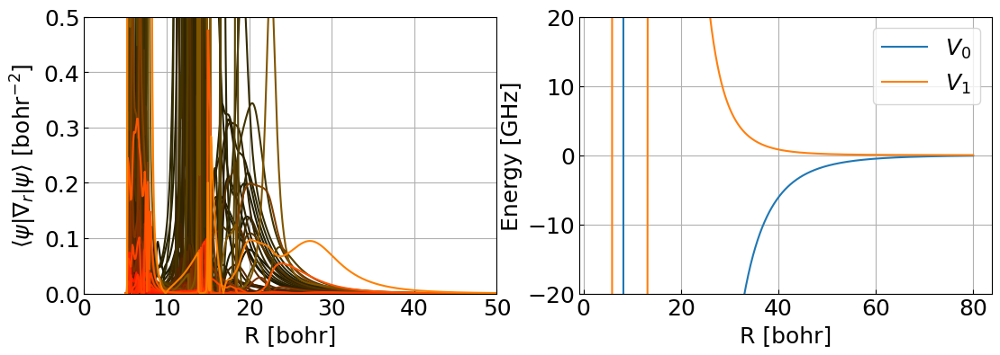

In [ ]:
data = utility.load(f"{DATA_PATH}/srf_rb_triplet_non_adiabatic_n_10.dat")

colors = np.array([(1 / (i + 1), (1 / (j + 1)), 0) for i in range(11) for j in range(i + 1, 11)])
fig, axes = utility.plot_many(1, 2, shape = (13, 4))

for i, c in reversed(list(enumerate(colors))):
    axes[0].plot(data[:, 0], data[:, i + 1], color = c)
axes[0].set_xlabel("R [bohr]")
axes[0].set_xlim(0, 80)
axes[0].set_ylabel(r"$\langle\psi|\nabla_r|\psi\rangle$ [bohr$^{-2}$]")

data = utility.load(f"{DATA_PATH}/SrF_Rb_triplet_dec_interpolated.dat")
scalings = data[:, 0]
values_legendre = data[:, 1:3]

axes[1].plot(scalings, values_legendre / GHZ)
axes[1].legend(["$V_0$", "$V_1$"])
axes[1].set_xlabel("R [bohr]")
axes[1].set_ylabel(r"Energy [GHz]")

axes[0].set_xlim(0, 50)
axes[0].set_ylim(0, 0.5)
axes[1].set_ylim(-20, 20)

(-20.0, 20.0)

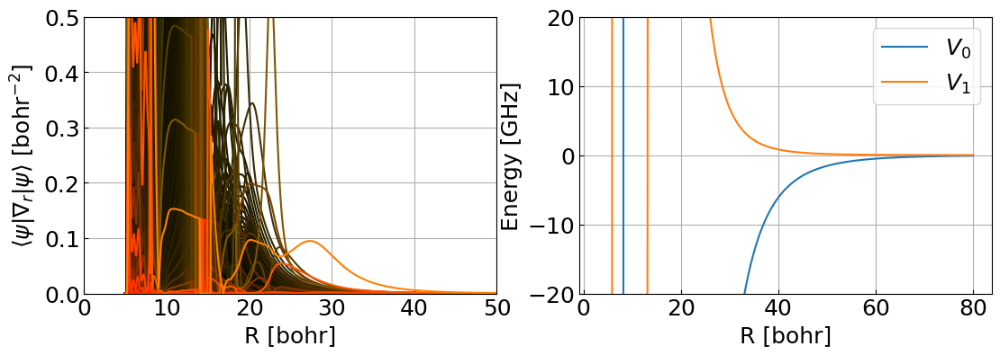

In [ ]:
data = utility.load(f"{DATA_PATH}/srf_rb_triplet_non_adiabatic_n_175.dat")

colors = np.array([(1 / (i + 1), (1 / (j + 1)), 0) for i in range(176) for j in range(i + 1, 176)])
fig, axes = utility.plot_many(1, 2, shape = (13, 4))

for i, c in reversed(list(enumerate(colors))):
    axes[0].plot(data[:, 0], data[:, i + 1], color = c)
axes[0].set_xlabel("R [bohr]")
axes[0].set_xlim(0, 80)
axes[0].set_ylabel(r"$\langle\psi|\nabla_r|\psi\rangle$ [bohr$^{-2}$]")

data = utility.load(f"{DATA_PATH}/SrF_Rb_triplet_dec_interpolated.dat")
scalings = data[:, 0]
values_legendre = data[:, 1:3]

axes[1].plot(scalings, values_legendre / GHZ)
axes[1].legend(["$V_0$", "$V_1$"])
axes[1].set_xlabel("R [bohr]")
axes[1].set_ylabel(r"Energy [GHz]")

axes[0].set_xlim(0, 50)
axes[0].set_ylim(0, 0.5)
axes[1].set_ylim(-20, 20)

# next

In [ ]:
import sys
sys.path.append("../../")
DATA_PATH = "../../data/"
SAVE_PATH = "../../plots"

import matplotlib.pyplot as plt
import numpy as np
import py_common.utility as utility
from py_common.units import *
from py_common.scattering_dependence import *
from py_common.bounds_dependence import *
from py_common.wave_function import *
from matplotlib.collections import LineCollection
import itertools
from matplotlib.figure import Figure
from matplotlib.axes import Axes
from py_common.utility import AxesArray
from ipywidgets import interact
import pickle
from py_common.aggregate_outputs import *

plt.rcParams.update({'font.size': 18})

n_colors = ["#FF0088", "#00FF9D", "#0BA6FF", "#8C0AE2"]
BINS = [-0.246, -1.660, -5.280]
ROT_CONST = 0.24975935 * CMINV / GHZ

reference_singlet_simple_1_00186 = np.loadtxt(f"{DATA_PATH}/wave_function_srf_rb_n_175_occupations_singlet_simple_1_00186.txt")
reference_triplet_simple_0_9986 = np.loadtxt(f"{DATA_PATH}/wave_function_srf_rb_n_175_occupations_triplet_simple_0_9986.txt")

colors = ["red", "green", "blue", "purple", "navy", "black"]

def bounds_loss(bounds, bounds_true):
    chi = 0
    for i in range(bounds_true.shape[0]):
        if i >= len(bounds):
            chi += 1
        else:
            chi += np.log2(bounds[i, 0] / bounds_true[i, 0])**2 + np.sum((bounds[i, 1:4] - bounds_true[i, 1:4])**2)
    chi /= 4 * i # type: ignore
    
    return chi

def bounds_losses(bounds, bounds_true):
    fields = np.unique(bounds.data[:, 0])

    losses = []
    for bounds_single in bounds.fields():
        losses.append(bounds_loss(bounds_single[:, 1:5], bounds_true))

    return np.array([np.array(fields), np.array(losses)])

def plot_bounds(ax: Axes, bounds: BoundsDependence, x_scaled = lambda x: x, reference = None, bins = True):
    for state in bounds.states():
        points = np.column_stack([x_scaled(state[:, 0]), np.cbrt(state[:, 1])])
        segments = np.stack([points[:-1], points[1:]], axis=1)
        colors = np.column_stack([state[:, 2], state[:, 3], state[:, 4]])
        
        lc = LineCollection(segments, colors=colors[:-1]) # type: ignore
        
        ax.add_collection(lc)
        ax.update_datalim(points)
    ax.autoscale_view()

    if bins:
        for b in BINS:
            ax.axhline(np.cbrt(b), color = "black", linestyle="--", linewidth=0.5)

    if reference is not None:
        for i in range(reference.shape[0]):
            ax.axhline(np.cbrt(reference[i, 0]), color = reference[i, 1:], linestyle="--", linewidth=1)

def plot_2d_bounds(
    bound_dependence: BoundsDependence2D, 
    reference: npt.NDArray[np.float64], 
    axis: int = 1, 
    c6_mult = 1.,
    label = "scaling view factor ="
) -> tuple[Figure, AxesArray]:
    fig, axes = utility.plot_many(1, 2, shape=(15, 5), sharex = True)

    def update(scaling_index = 0):
        for art in list(axes[0].lines):
            art.remove()
        for art in list(axes[0].collections):
            art.remove()

        bounds_index, scaling_view = bound_dependence.slice(scaling_index, axis)

        for state in bounds_index.states():
            if state.shape[1] == 3:
                axes[0].plot(state[:, 0], np.cbrt(state[:, 1]), color="blue")
            else:
                points = np.column_stack([state[:, 0], np.cbrt(state[:, 1])])
                segments = np.stack([points[:-1], points[1:]], axis=1)
                colors = np.column_stack([state[:, 2], state[:, 3], state[:, 4]])

                lc = LineCollection(segments, colors=colors[:-1]) # type: ignore
                
                axes[0].add_collection(lc)

        for i in range(reference.shape[0]):
            axes[0].axhline(np.cbrt(reference[i, 0]), color = reference[i, 1:], linestyle="--", linewidth=1)

        for b in BINS:
            axes[0].axhline(np.cbrt(b / c6_mult**0.5), color = "black", linestyle="--", linewidth=0.5)

        for art in list(axes[1].lines):
            art.remove()

        chi2 = bounds_losses(bounds_index, reference)
        axes[1].plot(chi2[0, :], chi2[1, :], color = "blue")

        fig.suptitle(f"{label} {scaling_view:.4f}")

        fig.canvas.draw_idle()
    
    update(scaling_index=0)

    interact(update, scaling_index = (0, bound_dependence.slice_len(axis) - 1))

    return fig, axes

@dataclass
class WKBLevel:
    n: int
    slope: float
    energy_diss: float
    intercept: float

    def levels_cbrt(self, lambd):
        return np.cbrt(self.energy_diss - np.power(self.slope * (np.sqrt(lambd) - self.intercept), 3) / np.sqrt(lambd))

class WKBLevels:
    levels: list[WKBLevel]
    slope: float
    rot_const: float
    spacing: float
    range_lambda: tuple[float, float]
    range_level_cbrt: tuple[float, float]

    def __init__(self, slope: float, rot_const: float, spacing: float, range_lambda: tuple[float, float], range_level_cbrt: tuple[float, float]):
        self.levels = []
        self.slope = slope
        self.rot_const = rot_const
        self.spacing = spacing
        self.range_lambda = range_lambda
        self.range_level_cbrt = range_level_cbrt

    # @staticmethod
    # def from_n_0(self, first, range_lambda: tuple[float, float], range_level_cbrt: tuple[float, float]) -> 'WKBLevels':
    #    pass

    def add_level_cbrt(self, n: int, point: tuple[float, float], slope: float | None = None, spacing: float | None = None):
        spacing = spacing if spacing is not None else self.spacing
        slope = slope if slope is not None else self.slope

        assert point[0] >= self.range_lambda[0] and point[0] <= self.range_lambda[1]
        assert point[1] >= self.range_level_cbrt[0] and point[1] <= self.range_level_cbrt[1]

        energy_diss = n * (n + 1) * self.rot_const
        intercept = np.cbrt(point[1]**3 * np.sqrt(point[0]) - energy_diss) / slope + np.sqrt(point[0])

        lowest_intercept = np.cbrt(self.range_level_cbrt[0]**3 * np.sqrt(self.range_lambda[0]) - energy_diss) / slope + np.sqrt(self.range_lambda[0])
        highest_intercept = np.cbrt(self.range_level_cbrt[1]**3 * np.sqrt(self.range_lambda[1]) - energy_diss) / slope + np.sqrt(self.range_lambda[1])

        k_min = int(np.ceil((lowest_intercept - intercept) / spacing))
        k_max = int(np.floor((highest_intercept - intercept) / spacing))

        for k in range(k_min, k_max + 1):
            self.levels.append(WKBLevel(n, slope, energy_diss, intercept + k * spacing))



# Singlet n_max = 10

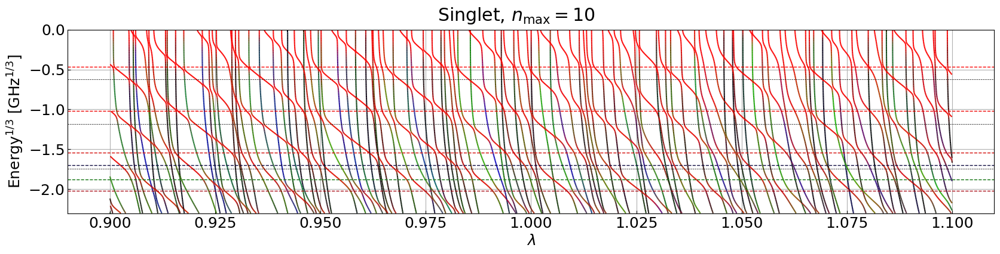

In [ ]:
fig, ax = utility.plot(shape = (20, 4))

bounds = BoundsDependence.parse_field_json(f"{DATA_PATH}/SrF_Rb_field_singlet_scaling_full_n_max_10_scaling_1_00.json")

plot_bounds(ax, bounds, reference=reference_singlet_simple_1_00186)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda$")
ax.set_ylim(-2.3, 0);

fig.savefig(f"{SAVE_PATH}/new/srf_rb_singlet_bounds_n_10.pdf", bbox_inches = "tight")
fig.suptitle(r"Singlet, $n_\text{max} = 10$");

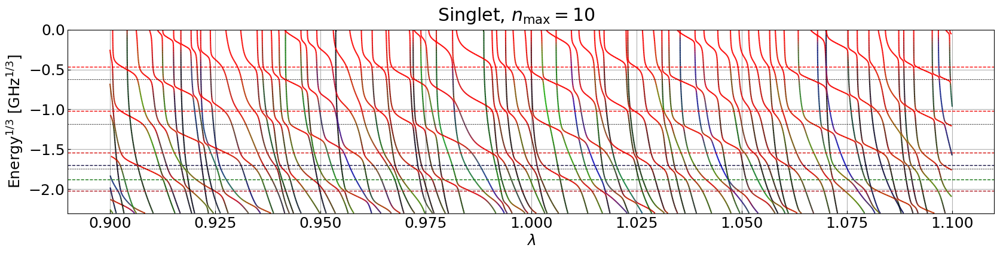

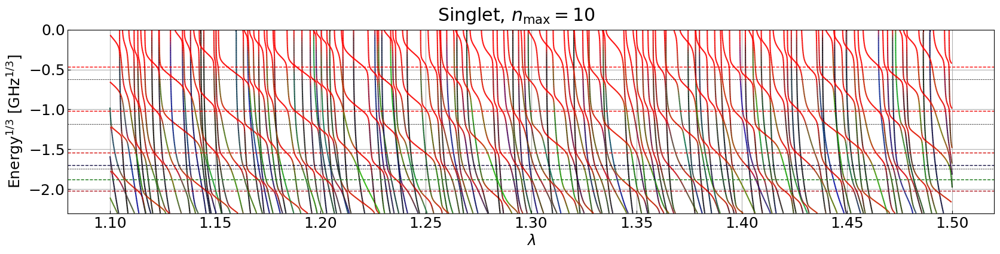

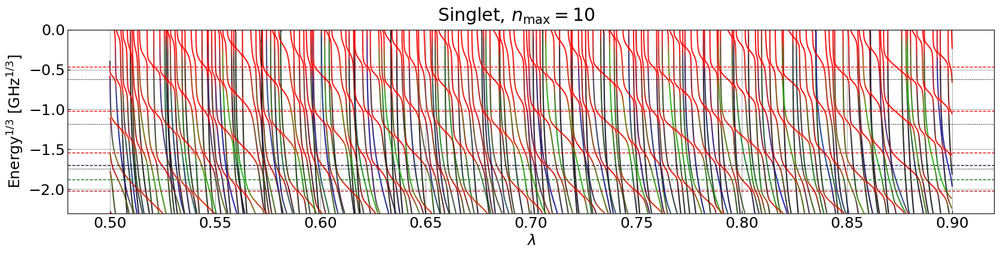

In [ ]:
fig, ax = utility.plot(shape = (20, 4))

bounds = BoundsDependence.parse_field_json(f"{DATA_PATH}/SrF_Rb_field_singlet_scaling_full_n_max_10_scaling_sr_1_00.json")

plot_bounds(ax, bounds, reference=reference_singlet_simple_1_00186)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda$")
ax.set_ylim(-2.3, 0);

# fig.savefig(f"{SAVE_PATH}/new/srf_rb_singlet_bounds_n_10.pdf", bbox_inches = "tight")
fig.suptitle(r"Singlet, $n_\text{max} = 10$");

fig, ax = utility.plot(shape = (20, 4))

bounds = BoundsDependence.parse_field_json(f"{DATA_PATH}/SrF_Rb_field_singlet_scaling_full_n_max_10_scaling_sr_1_30.json")

plot_bounds(ax, bounds, reference=reference_singlet_simple_1_00186)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda$")
ax.set_ylim(-2.3, 0);
fig.suptitle(r"Singlet, $n_\text{max} = 10$");

fig, ax = utility.plot(shape = (20, 4))

bounds = BoundsDependence.parse_field_json(f"{DATA_PATH}/SrF_Rb_field_singlet_scaling_full_n_max_10_scaling_sr_0_70.json")

plot_bounds(ax, bounds, reference=reference_singlet_simple_1_00186)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda$")
ax.set_ylim(-2.3, 0);
fig.suptitle(r"Singlet, $n_\text{max} = 10$");

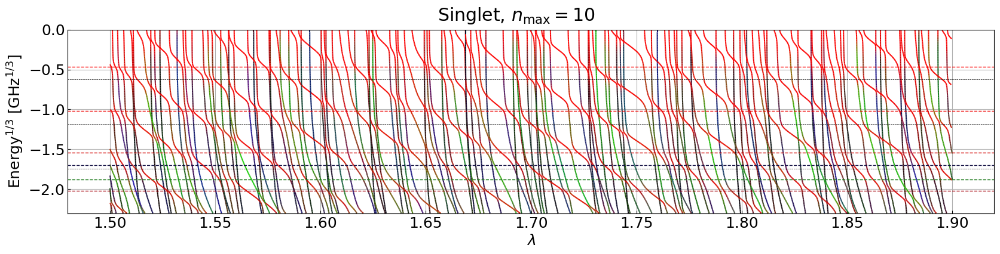

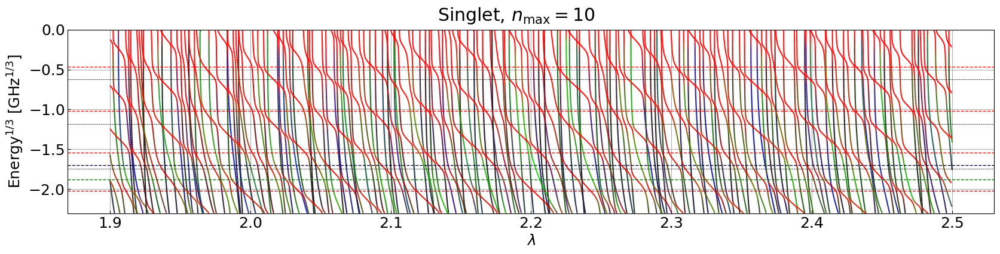

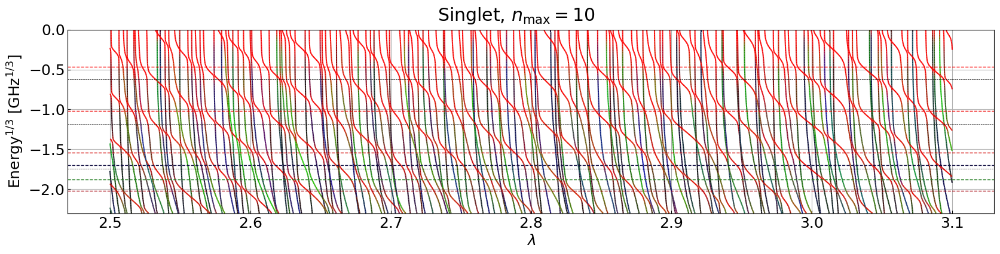

In [ ]:
fig, ax = utility.plot(shape = (20, 4))

bounds = BoundsDependence.parse_field_json(f"{DATA_PATH}/SrF_Rb_field_singlet_scaling_full_n_max_10_scaling_sr_1_70.json")

plot_bounds(ax, bounds, reference=reference_singlet_simple_1_00186)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda$")
ax.set_ylim(-2.3, 0);
fig.suptitle(r"Singlet, $n_\text{max} = 10$");

fig, ax = utility.plot(shape = (20, 4))

bounds = BoundsDependence.parse_field_json(f"{DATA_PATH}/SrF_Rb_field_singlet_scaling_full_n_max_10_scaling_sr_2_20.json")

plot_bounds(ax, bounds, reference=reference_singlet_simple_1_00186)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda$")
ax.set_ylim(-2.3, 0);
fig.suptitle(r"Singlet, $n_\text{max} = 10$");

fig, ax = utility.plot(shape = (20, 4))

bounds = BoundsDependence.parse_field_json(f"{DATA_PATH}/SrF_Rb_field_singlet_scaling_full_n_max_10_scaling_sr_2_80.json")

plot_bounds(ax, bounds, reference=reference_singlet_simple_1_00186)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda$")
ax.set_ylim(-2.3, 0);
fig.suptitle(r"Singlet, $n_\text{max} = 10$");

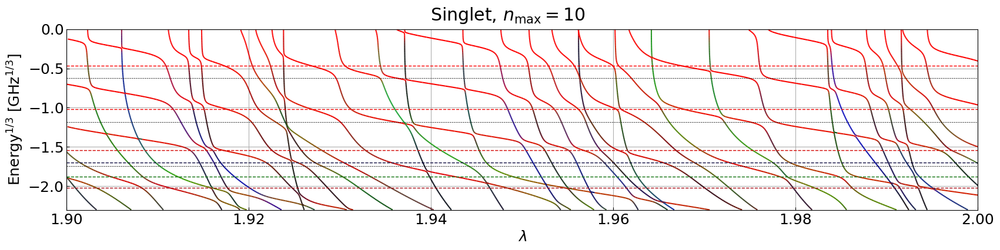

In [ ]:
fig, ax = utility.plot(shape = (20, 4))

bounds = BoundsDependence.parse_field_json(f"{DATA_PATH}/SrF_Rb_field_singlet_scaling_full_n_max_10_scaling_sr_2_20.json")

plot_bounds(ax, bounds, reference=reference_singlet_simple_1_00186)

ax.axvline(1.9)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda$")
ax.set_ylim(-2.3, 0);
ax.set_xlim(1.9, 2.0)
fig.suptitle(r"Singlet, $n_\text{max} = 10$");

interactive(children=(IntSlider(value=0, description='scaling_index', max=80), Output()), _dom_classes=('widge…

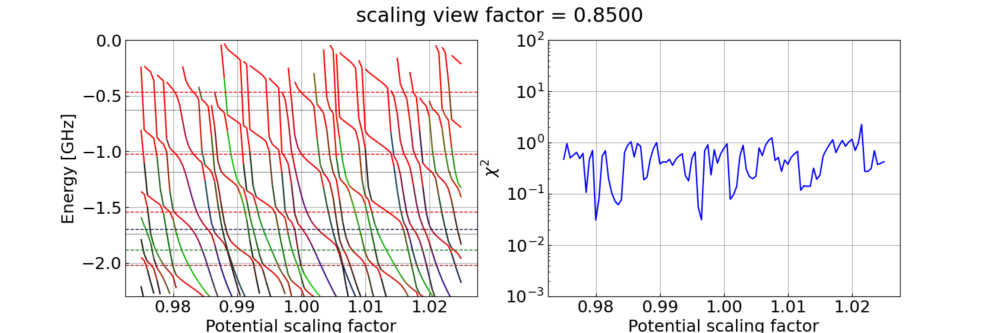

In [ ]:
# triplet n = 10 2d scaling zoomed
%matplotlib widget

bounds_singlet_2d_zoomed = BoundsDependence2D.parse_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_2d_scaling_n_max_10_scaling_1_00.json")
fig, axes = plot_2d_bounds(bounds_singlet_2d_zoomed, reference_singlet_simple_1_00186)

label = "Potential scaling factor"

axes[0].set_ylabel(f"Energy [GHz]")
axes[0].set_xlabel(label)
axes[0].set_ylim(-2.3, 0)

axes[1].set_yscale("log")
axes[1].set_ylim(1e-3, 1e2)
axes[1].set_ylabel(r"$\chi^2$")
axes[1].set_xlabel(label);

best scalings: [1.0262636558798472, 0.8663308327900304] \
scaling types: [Full, Anisotropic] \
chi2: 0.784181692966328 / 100

interactive(children=(IntSlider(value=0, description='scaling_index'), Output()), _dom_classes=('widget-intera…

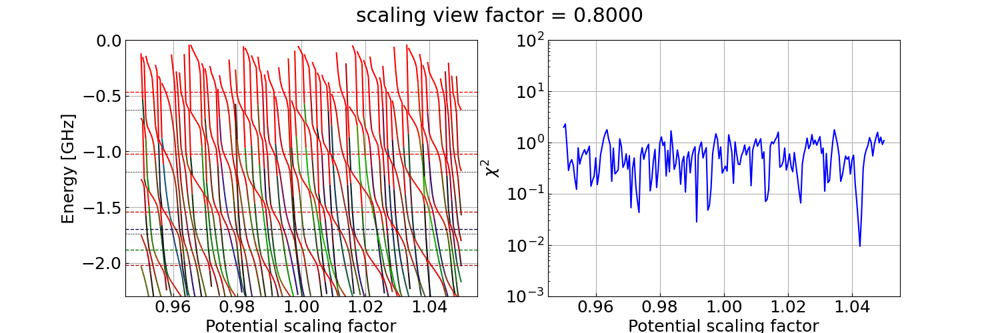

In [ ]:
# triplet n = 10 2d scaling zoomed
%matplotlib widget

bounds_singlet_2d_zoomed = BoundsDependence2D.parse_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_2d_scaling_n_max_10_scaling_1_00_long.json")
fig, axes = plot_2d_bounds(bounds_singlet_2d_zoomed, reference_singlet_simple_1_00186)

label = "Potential scaling factor"

axes[0].set_ylabel(f"Energy [GHz]")
axes[0].set_xlabel(label)
axes[0].set_ylim(-2.3, 0)

axes[1].set_yscale("log")
axes[1].set_ylim(1e-3, 1e2)
axes[1].set_ylabel(r"$\chi^2$")
axes[1].set_xlabel(label);

interactive(children=(IntSlider(value=0, description='scaling_index'), Output()), _dom_classes=('widget-intera…

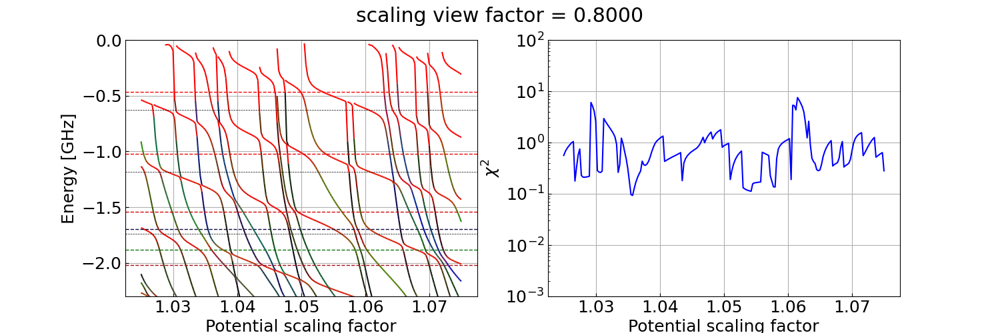

In [ ]:
# triplet n = 10 2d scaling zoomed
%matplotlib widget

bounds_singlet_2d_zoomed = BoundsDependence2D.parse_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_2d_scaling_n_max_10_sr_scaling_1_05.json")
fig, axes = plot_2d_bounds(bounds_singlet_2d_zoomed, reference_singlet_simple_1_00186)

label = "Potential scaling factor"

axes[0].set_ylabel(f"Energy [GHz]")
axes[0].set_xlabel(label)
axes[0].set_ylim(-2.3, 0)

axes[1].set_yscale("log")
axes[1].set_ylim(1e-3, 1e2)
axes[1].set_ylabel(r"$\chi^2$")
axes[1].set_xlabel(label);

-0.10265304883207281 [0.94736842 0.00832947 0.01086514 0.00392858 0.00330596 0.0211375 ]
-0.9823571084871567 [0.91452312 0.01944986 0.01963066 0.00724584 0.00441746 0.02783936]
-3.578725670811309 [0.8573514  0.06862235 0.0134039  0.02294917 0.00747197 0.02412694]
-3.7522128365810468 [0.09285374 0.12933335 0.12331153 0.24958748 0.13763902 0.23332734]
-7.137007903979161 [0.10804678 0.66797637 0.04380587 0.04442121 0.02468191 0.09498887]
-9.189469222114345 [0.88466187 0.04441145 0.02292728 0.01711414 0.00581218 0.0208103 ]


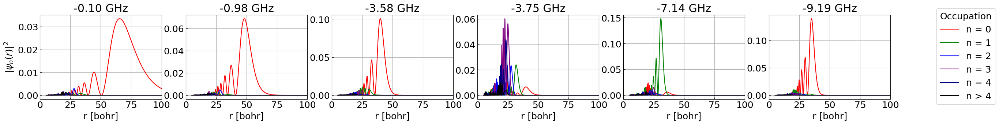

In [ ]:
n_max = 5
take = 6

wave_functions = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_wave_functions_n_max_10_scaling_1_02_0_87.json", n_max + 1)

fig, axes = utility.plot_many(1, take, shape = (5 * take, 3))
axes[0].set_ylabel(r"$|\psi_n(r)|^2$")

for i, (n, wave) in itertools.islice(enumerate(wave_functions.items()), take):
    print(wave.energy, end = " ")
    print(wave.occupations)

    for j in range(wave.values.shape[1]):
        axes[i].plot(wave.distances, wave.values[:, j] ** 2, color = colors[j])

    axes[i].set_xlabel("r [bohr]")
    axes[i].set_title(f"{wave.energy:.2f} GHz")
    axes[i].set_xlim(0, 100)

fig.legend([*(f"n = {j}" for j in range(n_max)), rf"n > {n_max-1}"],
           loc='center right', bbox_to_anchor=(1, 0.5),
           title='Occupation');
    
fig.savefig(f"{SAVE_PATH}/new/wave_function_singlet_n_10_1_02_0_87.pdf", bbox_inches = "tight")

best scalings: [1.0841421301120646, 0.9100983303880654] \
scaling types: [Full, Anisotropic] \
chi2: 0.9103681467849691

-0.10176970730555374 [0.91167619 0.05100456 0.00498741 0.01567547 0.00599169 0.00783657]
-0.9112134787319414 [0.89989773 0.0566563  0.0066153  0.01725908 0.00693755 0.00934273]
-3.373256646421418 [0.91915662 0.04851023 0.00803189 0.00920574 0.00505962 0.00730255]
-3.818471895123518 [0.02820367 0.15055883 0.08725378 0.09507321 0.27867381 0.1831694 ]
-7.503611448789197 [0.09335657 0.48062785 0.04058502 0.18762025 0.03170203 0.13180444]
-8.673076630750487 [0.89045929 0.0430834  0.01397849 0.02461114 0.00506612 0.01918758]


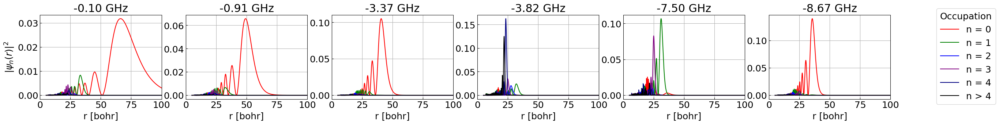

In [ ]:
n_max = 5
take = 6

wave_functions = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_wave_functions_n_max_10_scaling_1_08_0_91.json", n_max + 1)

fig, axes = utility.plot_many(1, take, shape = (5 * take, 3))
axes[0].set_ylabel(r"$|\psi_n(r)|^2$")

for i, (n, wave) in itertools.islice(enumerate(wave_functions.items()), take):
    print(wave.energy, end = " ")
    print(wave.occupations)
    
    for j in range(wave.values.shape[1]):
        axes[i].plot(wave.distances, wave.values[:, j] ** 2, color = colors[j])

    axes[i].set_xlabel("r [bohr]")
    axes[i].set_title(f"{wave.energy:.2f} GHz")
    axes[i].set_xlim(0, 100)

fig.legend([*(f"n = {j}" for j in range(n_max)), rf"n > {n_max-1}"],
           loc='center right', bbox_to_anchor=(1, 0.5),
           title='Occupation');

# fig.savefig(f"{SAVE_PATH}/wave_function_singlet_n_175_scaled.pdf", bbox_inches = "tight")

-0.09741627527922318 [0.98615627 0.00401779 0.00169977 0.00249204 0.00198878 0.00315119]
-1.03173398215095 [0.95165873 0.01336726 0.00583454 0.01036429 0.00610988 0.01102094]
-3.7099162710256235 [0.85834543 0.02345528 0.02786047 0.02033042 0.01382873 0.05108279]
-3.9993243092458153 [0.10669272 0.43928735 0.26594134 0.05215179 0.01763195 0.10063768]
-6.711401416658447 [0.12345512 0.15380736 0.24827363 0.31066449 0.02596492 0.12438128]
-9.277383742746764 [0.73486615 0.16075243 0.06718832 0.00996524 0.00565396 0.01751081]


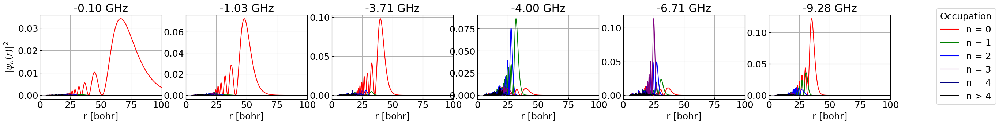

In [ ]:
n_max = 5
take = 6

wave_functions = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_singlet_wave_functions_n_max_10_scaling_test.json", n_max + 1)

fig, axes = utility.plot_many(1, take, shape = (5 * take, 3))
axes[0].set_ylabel(r"$|\psi_n(r)|^2$")

for i, (n, wave) in itertools.islice(enumerate(wave_functions.items()), take):
    print(wave.energy, end = " ")
    print(wave.occupations)

    for j in range(wave.values.shape[1]):
        axes[i].plot(wave.distances, wave.values[:, j] ** 2, color = colors[j])

    axes[i].set_xlabel("r [bohr]")
    axes[i].set_title(f"{wave.energy:.2f} GHz")
    axes[i].set_xlim(0, 100)

fig.legend([*(f"n = {j}" for j in range(n_max)), rf"n > {n_max-1}"],
           loc='center right', bbox_to_anchor=(1, 0.5),
           title='Occupation');
    
# fig.savefig(f"{SAVE_PATH}/wave_function_singlet_n_175_scaled.pdf", bbox_inches = "tight")

# Triplet n_max = 10

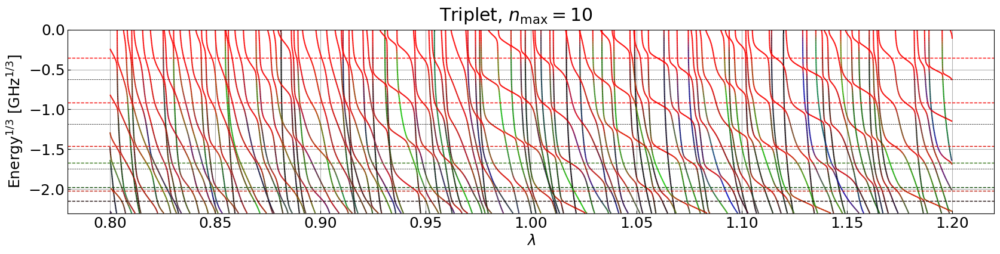

In [ ]:
fig, ax = utility.plot(shape = (20, 4))

bounds = BoundsDependence.parse_field_json(f"{DATA_PATH}/SrF_Rb_field_triplet_scaling_full_n_max_10_scaling_1_00.json")

plot_bounds(ax, bounds, reference=reference_triplet_simple_0_9986)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda$")
ax.set_ylim(-2.3, 0);

fig.savefig(f"{SAVE_PATH}/new/srf_rb_triplet_bounds_n_10.pdf", bbox_inches = "tight")
fig.suptitle(r"Triplet, $n_\text{max} = 10$");

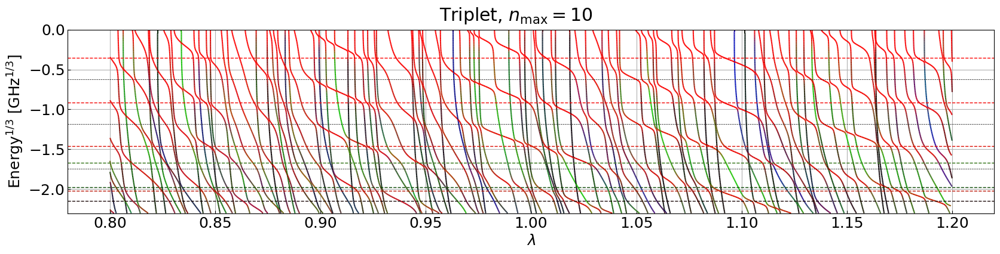

In [ ]:
fig, ax = utility.plot(shape = (20, 4))

bounds = BoundsDependence.parse_field_json(f"{DATA_PATH}/SrF_Rb_field_triplet_scaling_full_n_max_10_scaling_sr_1_00.json")

plot_bounds(ax, bounds, reference=reference_triplet_simple_0_9986)

ax.set_ylabel("Energy$^{1/3}$ [GHz$^{1/3}$]")
ax.set_xlabel(r"$\lambda$")
ax.set_ylim(-2.3, 0);

fig.savefig(f"{SAVE_PATH}/new/srf_rb_triplet_bounds_n_10.pdf", bbox_inches = "tight")
fig.suptitle(r"Triplet, $n_\text{max} = 10$");

interactive(children=(IntSlider(value=0, description='scaling_index', max=80), Output()), _dom_classes=('widge…

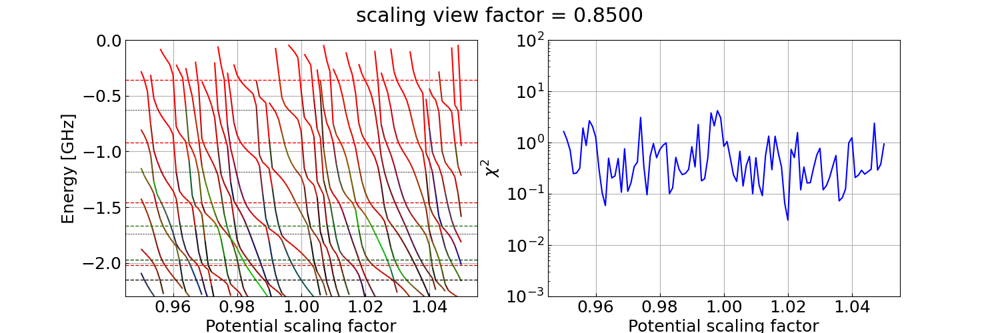

In [ ]:
# triplet n = 10 2d scaling zoomed
%matplotlib widget

bounds_triplet_2d_zoomed = BoundsDependence2D.parse_json(f"{DATA_PATH}/SrF_Rb_bounds_triplet_2d_scaling_n_max_10_scaling_1_00.json")
fig, axes = plot_2d_bounds(bounds_triplet_2d_zoomed, reference_triplet_simple_0_9986)

label = "Potential scaling factor"

axes[0].set_ylabel(f"Energy [GHz]")
axes[0].set_xlabel(label)
axes[0].set_ylim(-2.3, 0)

axes[1].set_yscale("log")
axes[1].set_ylim(1e-3, 1e2)
axes[1].set_ylabel(r"$\chi^2$")
axes[1].set_xlabel(label);

interactive(children=(IntSlider(value=0, description='scaling_index'), Output()), _dom_classes=('widget-intera…

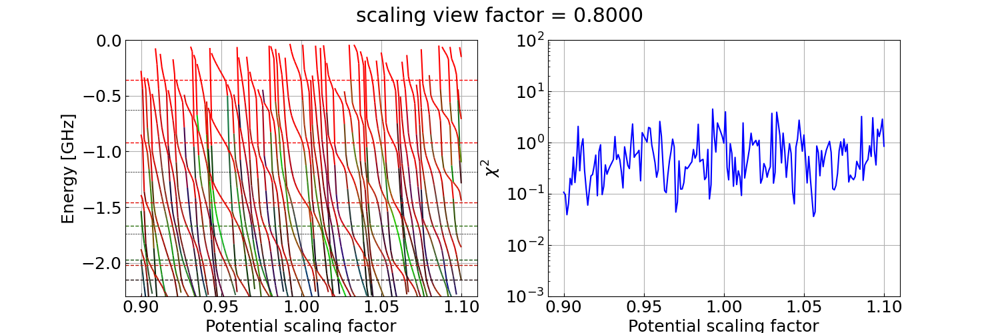

In [ ]:
# triplet n = 10 2d scaling zoomed
%matplotlib widget

bounds_triplet_2d_zoomed = BoundsDependence2D.parse_json(f"{DATA_PATH}/SrF_Rb_bounds_triplet_2d_scaling_n_max_10_scaling_1_00_long.json")
fig, axes = plot_2d_bounds(bounds_triplet_2d_zoomed, reference_triplet_simple_0_9986)

label = "Potential scaling factor"

axes[0].set_ylabel(f"Energy [GHz]")
axes[0].set_xlabel(label)
axes[0].set_ylim(-2.3, 0)

axes[1].set_yscale("log")
axes[1].set_ylim(1e-3, 1e2)
axes[1].set_ylabel(r"$\chi^2$")
axes[1].set_xlabel(label);

interactive(children=(IntSlider(value=0, description='scaling_index'), Output()), _dom_classes=('widget-intera…

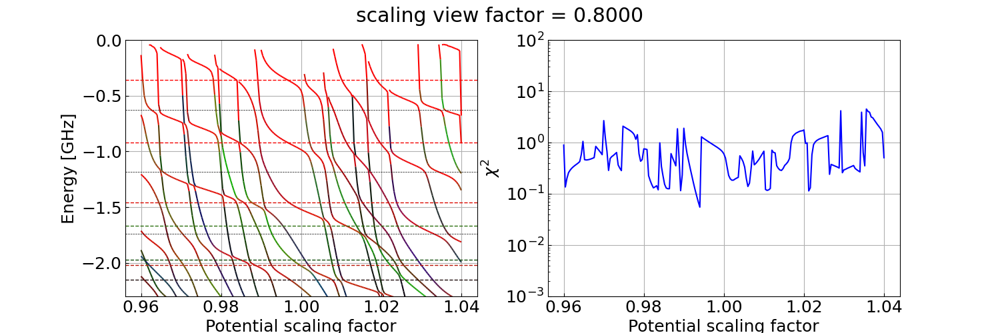

In [ ]:
# triplet n = 10 2d scaling zoomed
%matplotlib widget

bounds_triplet_2d_zoomed = BoundsDependence2D.parse_json(f"{DATA_PATH}/SrF_Rb_bounds_triplet_2d_scaling_n_max_10_sr_scaling_1_00.json")
fig, axes = plot_2d_bounds(bounds_triplet_2d_zoomed, reference_triplet_simple_0_9986)

label = "Potential scaling factor"

axes[0].set_ylabel(f"Energy [GHz]")
axes[0].set_xlabel(label)
axes[0].set_ylim(-2.3, 0)

axes[1].set_yscale("log")
axes[1].set_ylim(1e-3, 1e2)
axes[1].set_ylabel(r"$\chi^2$")
axes[1].set_xlabel(label);

best scalings: [1.11114264265224, 0.989117739325556] \
scaling types: [Full, Anisotropic] \
chi2: 0.18360210486796522 / 100

-0.04620304895374759 [9.92781082e-01 3.51632914e-03 1.02392135e-03 1.07381827e-03
 5.70147634e-04 9.21560638e-04]
-0.757883686054877 [0.96204223 0.01913315 0.00519805 0.00613532 0.0026753  0.00431131]
-3.0818949829638536 [0.91594524 0.0473727  0.01056675 0.01457343 0.00419346 0.00628539]
-4.745675918784368 [0.08327277 0.41904034 0.02133262 0.07686604 0.24112859 0.11703432]
-7.424182751177492 [0.06562441 0.3789763  0.08966508 0.02886756 0.16512167 0.24246342]
-7.8946608623564485 [0.80540241 0.04683783 0.02092191 0.08382143 0.01808309 0.01431303]


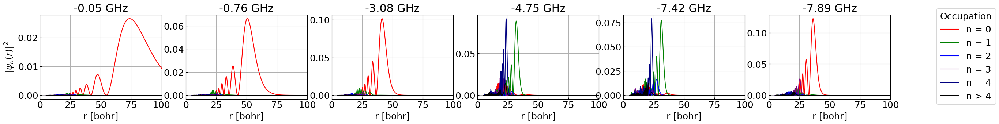

In [ ]:
n_max = 5
take = 6

wave_functions = wavefunction_json(f"{DATA_PATH}/SrF_Rb_bounds_triplet_wave_functions_n_max_10_scaling_1_11_0_99.json", n_max + 1)

fig, axes = utility.plot_many(1, take, shape = (5 * take, 3))
axes[0].set_ylabel(r"$|\psi_n(r)|^2$")

for i, (n, wave) in itertools.islice(enumerate(wave_functions.items()), take):
    print(wave.energy, end = " ")
    print(wave.occupations)
    
    for j in range(wave.values.shape[1]):
        axes[i].plot(wave.distances, wave.values[:, j] ** 2, color = colors[j])

    axes[i].set_xlabel("r [bohr]")
    axes[i].set_title(f"{wave.energy:.2f} GHz")
    axes[i].set_xlim(0, 100)

fig.legend([*(f"n = {j}" for j in range(n_max)), rf"n > {n_max-1}"],
           loc='center right', bbox_to_anchor=(1, 0.5),
           title='Occupation');
    
fig.savefig(f"{SAVE_PATH}/new/wave_function_triplet_n_10_1_11_0_99.pdf", bbox_inches = "tight")